# Introduction to Deep Learning

<div style="text-align: right">   </div>


Introduction to Deep Learning (2024) &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp;&nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp;&nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp;&nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp;&nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp;| &nbsp;
-------|-------------------
**Assignment 1, Part 3: Generative Models** | <img src="https://upload.wikimedia.org/wikipedia/commons/thumb/b/b0/UniversiteitLeidenLogo.svg/1280px-UniversiteitLeidenLogo.svg.png" width="300">


In this notebook we are going to cover two generative models for generating novel images:

1. Variational Autoencoders (**VAEs**)
2. Generative adversarial networks (**GANs**)


<img src="https://lilianweng.github.io/lil-log/assets/images/three-generative-models.png" width="500">


Your main goal will be to retrain these models on a dataset of your choice and do some experiments on the learned latent space.

You should first copy this notebook and enable GPU runtime in 'Runtime -> Change runtime type -> Hardware acceleration -> GPU **OR** TPU'.


In [ ]:
# !pip install 'tensorflow[and-gpu]'==2.14 ##

In [2]:
from tqdm import tqdm
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import os
import zipfile
import numpy as np
from PIL import Image

from google.colab import drive
# drive.mount('/content/drive', force_remount=True) ## If you want to use your google drive


### Dataset

*Dataset description*

We are using a dataset from Kaggle that contains anime faces. The dataset is stored in a .zip file, which we extract to access the images. After extraction, the images are saved as a .npy file, and we load it into memory for training. The dataset consists of 64x64 RGB images representing different anime characters. This dataset allows us to experiment with generative models like VAEs and GANs to generate new anime faces.

This is the link to the dataset.

https://www.kaggle.com/datasets/splcher/animefacedataset



Download the dataset from Kaggle

In [3]:
!kaggle datasets download -d splcher/animefacedataset

Dataset URL: https://www.kaggle.com/datasets/splcher/animefacedataset
License(s): DbCL-1.0
 97% 382M/395M [00:02<00:00, 207MB/s]
100% 395M/395M [00:02<00:00, 181MB/s]


Extract the .zip file

In [4]:
import zipfile
import os

# Unzip the dataset
with zipfile.ZipFile("/content/animefacedataset.zip", 'r') as zip_ref:
    zip_ref.extractall("anime_faces")

# List the extracted files
os.listdir("anime_faces")

['images']

Convert the dataset into .npy

This is its importance:
  - This reduces the overall disk space required for storage compared to keeping a folder full of individual image files.
  - With .npy, you can ensure the entire dataset is uniform.

In [5]:
# Path to the images folder
images_folder = "/content/anime_faces/images"

# List to store image arrays
image_data = []

# Loop through all files in the folder
for file_name in os.listdir(images_folder):
    file_path = os.path.join(images_folder, file_name)

    # Check if it's an image
    if file_name.endswith((".png", ".jpg", ".jpeg")):
        # Load the image
        img = Image.open(file_path)

        # Resize images to a fixed size
        img = img.resize((64, 64))

        # Convert to numpy array
        img_array = np.array(img)

        # Add to the list
        image_data.append(img_array)

# Convert the list to a numpy array
image_data = np.array(image_data)

# Save the numpy array to a .npy file
np.save("anime_faces.npy", image_data)

print("Saved images as anime_faces.npy")

Saved images as anime_faces.npy


Load the dataset

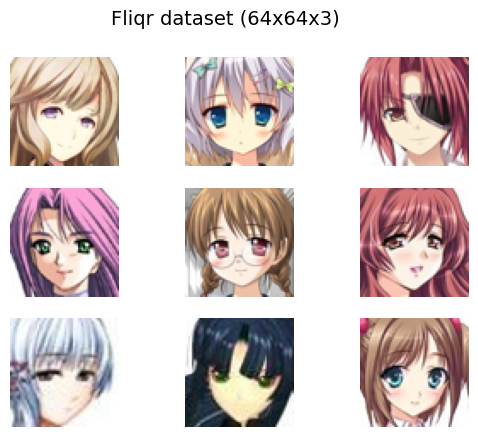

In [6]:
def load_real_samples(scale=False):
    # We load the data
    X = np.load('/content/anime_faces.npy',  fix_imports=True,encoding='latin1')[:, :, :, :]
    # Scale samples in range [-127, 127]
    if scale:
        X = (X - 127.5) * 2
    return X / 255.

# We will use this function to display the output of our models throughout this notebook
def grid_plot(images, epoch='', name='', n=3, save=False, scale=False):
    if scale:
        images = (images + 1) / 2.0
    for index in range(n * n):
        plt.subplot(n, n, 1 + index)
        plt.axis('off')
        plt.imshow(images[index])
    fig = plt.gcf()
    fig.suptitle(name + '  '+ str(epoch), fontsize=14)
    if save:
        filename = 'results/generated_plot_e%03d_f.png' % (epoch+1)
        plt.savefig(filename)
        plt.close()
    plt.show()

dataset = load_real_samples()
grid_plot(dataset[np.random.randint(0, 1000, 9)], name='Fliqr dataset (64x64x3)', n=3)

We see that all the 63,565 images have been loaded successfully

In [7]:
# Check the shape of the dataset
dataset.shape

(63565, 64, 64, 3)

Data Augmentation:

We'll use TensorFlow's ImageDataGenerator for augmentations such as random rotations, shifts, flips, and zooms. This will help to increase the diversity of the training dataset and improve model robustness.

In [8]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

def create_augmentation_pipeline(target_size=(128, 128)):
    """
    Creates a pipeline for augmenting images.
    It also resizes images to a smaller target size to reduce memory usage.
    """
    # Augmentation setup
    datagen = ImageDataGenerator(
        rotation_range=20,          # Randomly rotate images by up to 20 degrees
        width_shift_range=0.2,      # Shift images horizontally
        height_shift_range=0.2,     # Shift images vertically
        shear_range=0.2,            # Shear transformation
        zoom_range=0.2,             # Zoom randomly
        horizontal_flip=True,       # Randomly flip images horizontally
        fill_mode='nearest'         # Fill in missing pixels after transformations
    )

    return datagen

Once we've defined the augmentation pipeline, lets can apply it to our dataset.

In [9]:
# Create the augmentation pipeline
datagen = create_augmentation_pipeline()

# Apply augmentations
augmented_data = datagen.flow(dataset, batch_size=64)  # This generates augmented batches

## 2.1. Introduction

The generative models that we are going to cover both have the following components:

1. A downsampling architecture (encoder in case of VAE, and discriminator in case of GAN) to either extract features from the data or model its distribution.
2. An upsampling architecture (decoder for VAE, generator for GAN) that will use some kind of latent vector to generate new samples that resemble the data that it was trained on.

Since we are going to be dealing with images, we are going to use convolutional networks for upsampling and downsampling, similar to what you see below.

<img src="https://i2.wp.com/sefiks.com/wp-content/uploads/2018/03/convolutional-autoencoder.png" width="500">


#### Code for building these components:

In [ ]:
from tensorflow.keras.layers import Dense, Flatten, Conv2D, Conv2DTranspose, Reshape

def build_conv_net(in_shape, out_shape, n_downsampling_layers=4, filters=128, out_activation='sigmoid'):
    """
    Build a basic convolutional network
    """
    default_args=dict(kernel_size=(3,3), strides=(2,2), padding='same', activation='relu')

    input = tf.keras.Input(shape=in_shape)
    x = Conv2D(filters=filters, name='enc_input', **default_args)(input)

    for _ in range(n_downsampling_layers):
        x = Conv2D(**default_args, filters=filters)(x)

    x = Flatten()(x)
    x = Dense(out_shape, activation=out_activation, name='enc_output')(x)

    model = tf.keras.Model(inputs=input, outputs=x, name='Encoder')

    model.summary()
    return model


def build_deconv_net(latent_dim, n_upsampling_layers=4, filters=128, activation_out='sigmoid'):
    """
    Build a deconvolutional network for decoding/upscaling latent vectors

    When building the deconvolutional architecture, usually it is best to use the same layer sizes that
    were used in the downsampling network and the Conv2DTranspose layers are used instead of Conv2D layers.
    Using identical layers and hyperparameters ensures that the dimensionality of our output matches the
    shape of our input images.
    """
    input = tf.keras.Input(shape=(latent_dim,))
    x = Dense(4 * 4 * 64, input_dim=latent_dim, name='dec_input')(input)
    x = Reshape((4, 4, 64))(x) # This matches the output size of the downsampling architecture

    default_args=dict(kernel_size=(3,3), strides=(2,2), padding='same', activation='relu')

    for i in range(n_upsampling_layers):
        x = Conv2DTranspose(filters=filters, **default_args)(x)

    # This last convolutional layer converts back to 3 channel RGB image
    x = Conv2D(filters=3, kernel_size=(3,3), padding='same', activation=activation_out, name='dec_output')(x)

    model = tf.keras.Model(inputs=input, outputs=x, name='Decoder')
    model.summary()
    return model

### Convolutional Autoencoder example

Using these two basic building blocks we can now build a Convolutional Autoencoder (CAE).

<img src="https://lilianweng.github.io/lil-log/assets/images/autoencoder-architecture.png" width="500">



Even though it's not a generative model, CAE is a great way to illustrate how these two components (convolutional and deconvolutional networks) can be used together to reconstruct images.

You can view such model as a compression/dimensionality reduction method as each image gets compressed to a vector of 256 numbers by the encoder and gets decompressed back into an image using the decoder network.

Model: "Encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 64, 64, 3)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ enc_input (Conv2D)                   │ (None, 32, 32, 32)          │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 16, 16, 32)          │           9,248 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 8, 8, 32)            │           9,248 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 4, 4, 32)            │           9,248 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 2, 2, 32)            │           9,248 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ enc_output (Dense)                   │ (None, 32)                  │           4,128 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 42,016 (164.12 KB)

 Trainable params: 42,016 (164.12 KB)

 Non-trainable params: 0 (0.00 B)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "Decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 32)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dec_input (Dense)                    │ (None, 1024)                │          33,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape (Reshape)                    │ (None, 4, 4, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose (Conv2DTranspose)   │ (None, 8, 8, 32)            │          18,464 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_1 (Conv2DTranspose) │ (None, 16, 16, 32)          │           9,248 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_2 (Conv2DTranspose) │ (None, 32, 32, 32)          │           9,248 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_3 (Conv2DTranspose) │ (None, 64, 64, 32)          │           9,248 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dec_output (Conv2D)                  │ (None, 64, 64, 3)           │             867 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 80,867 (315.89 KB)

 Trainable params: 80,867 (315.89 KB)

 Non-trainable params: 0 (0.00 B)


Epoch:  0
994/994 ━━━━━━━━━━━━━━━━━━━━ 23s 15ms/step - loss: 0.5897
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 710ms/step


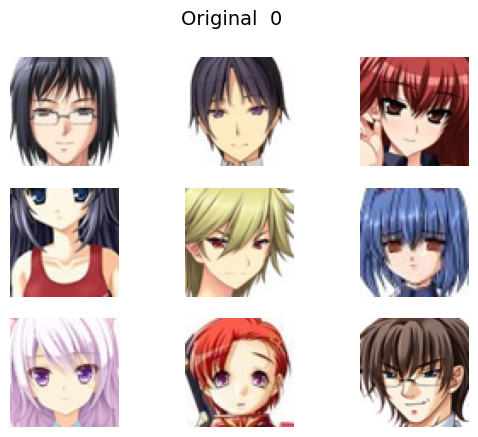

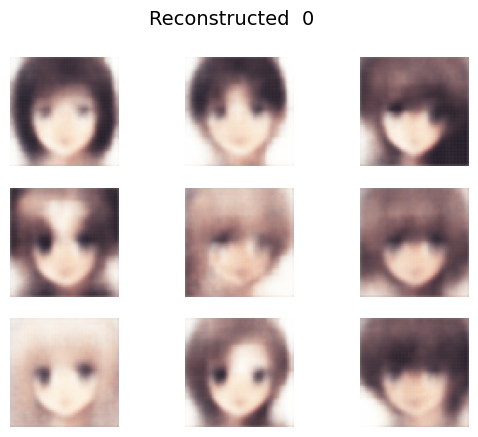


Epoch:  1
994/994 ━━━━━━━━━━━━━━━━━━━━ 13s 13ms/step - loss: 0.5442
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


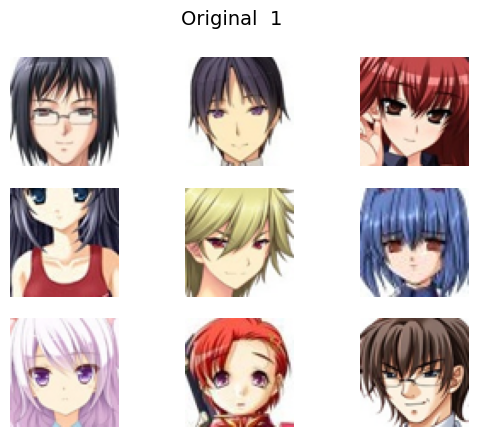

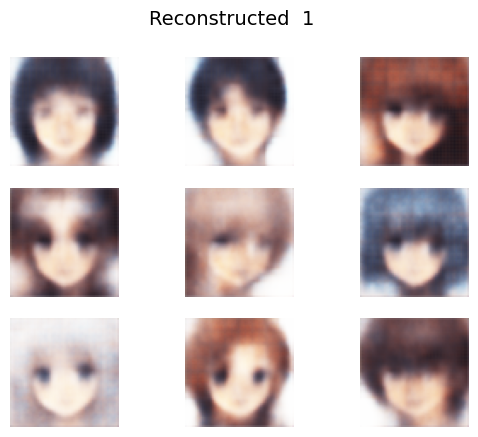


Epoch:  2
994/994 ━━━━━━━━━━━━━━━━━━━━ 13s 13ms/step - loss: 0.5358
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


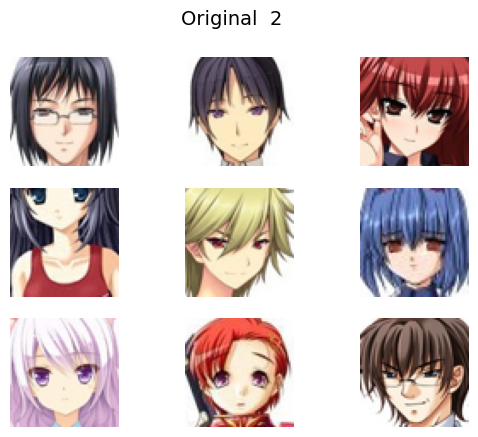

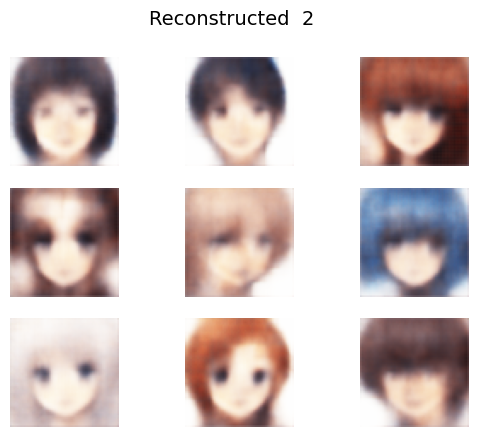


Epoch:  3
994/994 ━━━━━━━━━━━━━━━━━━━━ 13s 13ms/step - loss: 0.5329
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


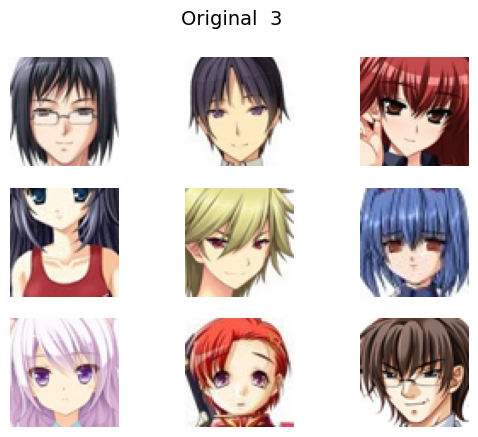

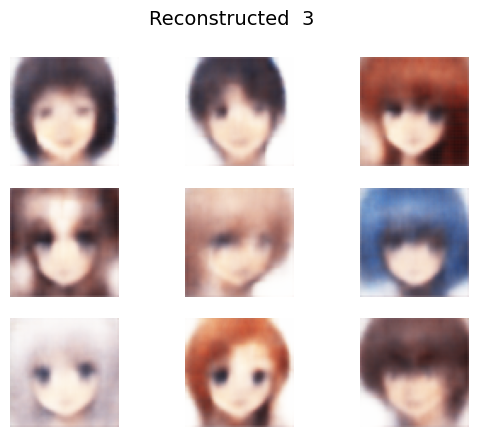


Epoch:  4
994/994 ━━━━━━━━━━━━━━━━━━━━ 13s 13ms/step - loss: 0.5318
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


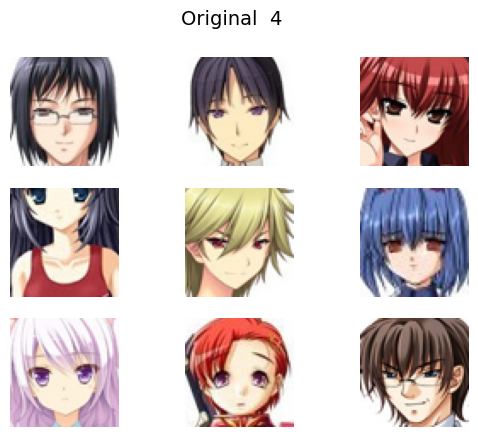

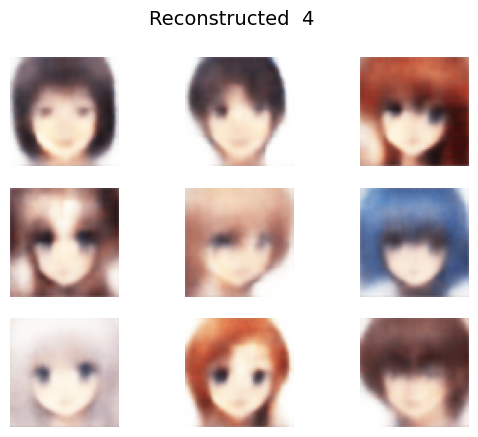


Epoch:  5
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5311
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


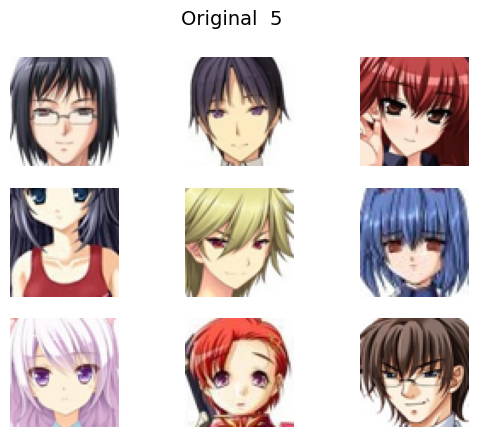

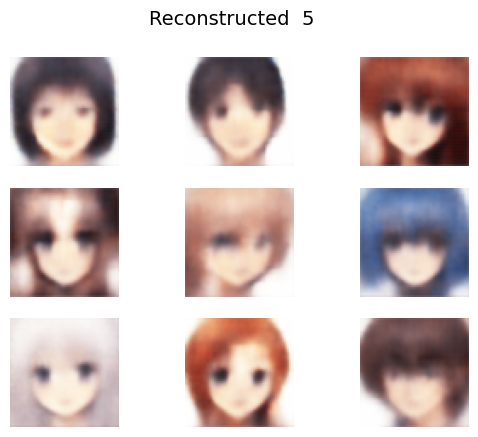


Epoch:  6
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5304
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


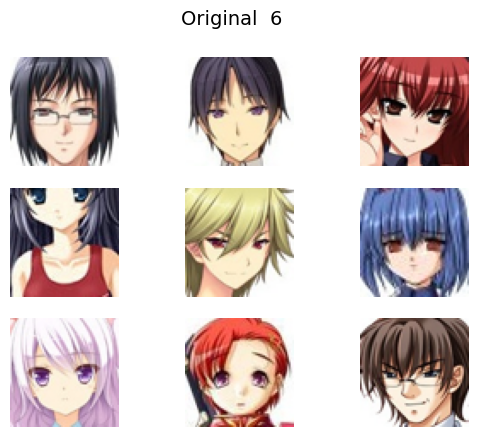

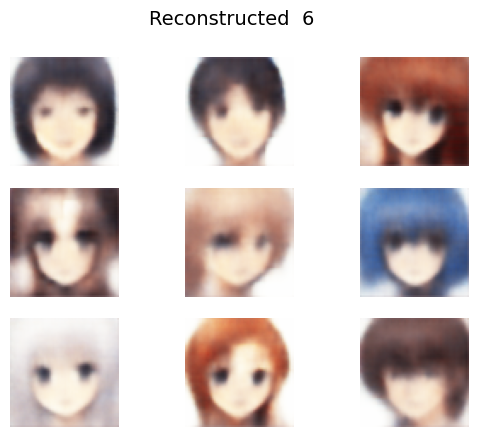


Epoch:  7
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5298
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


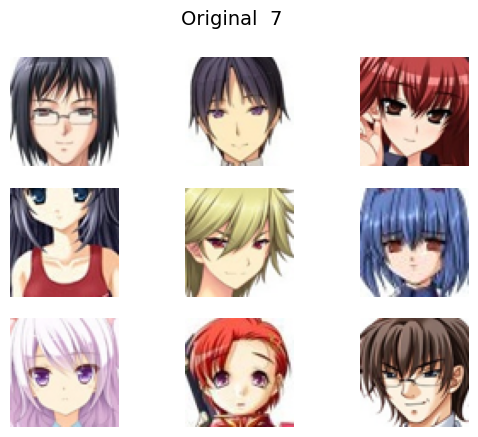

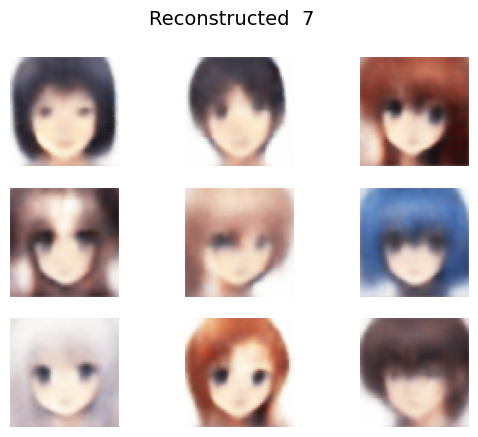


Epoch:  8
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5299
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


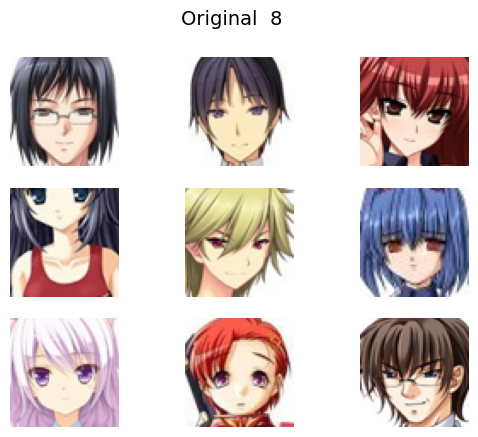

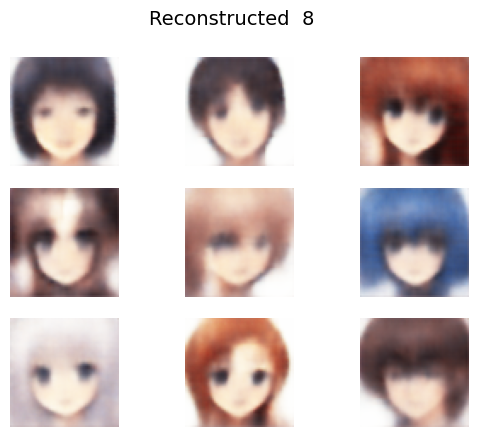


Epoch:  9
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5292
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


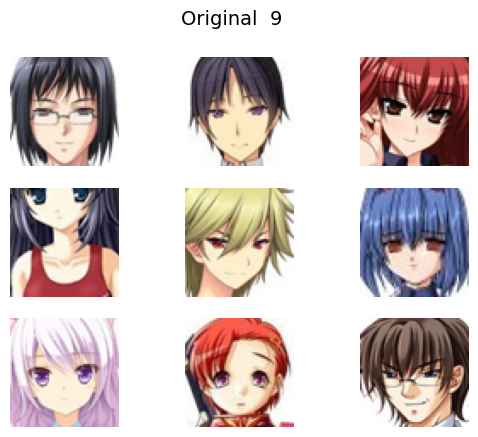

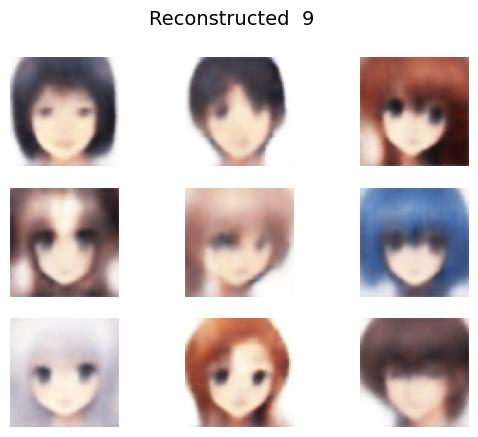


Epoch:  10
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5290
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


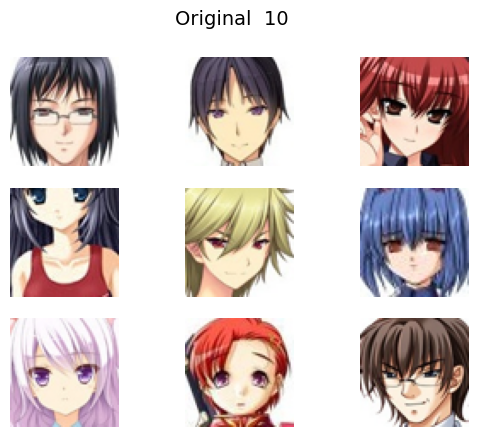

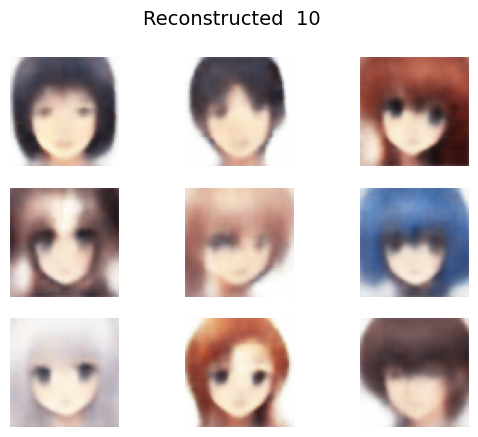


Epoch:  11
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5284
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


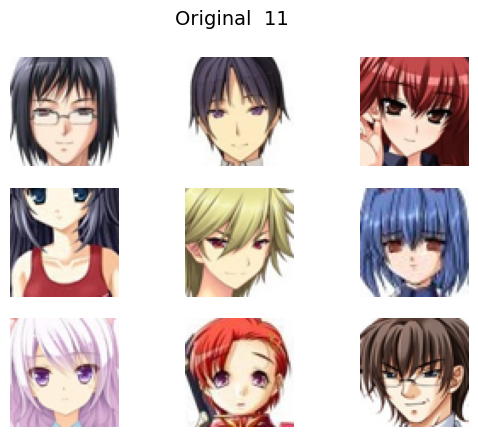

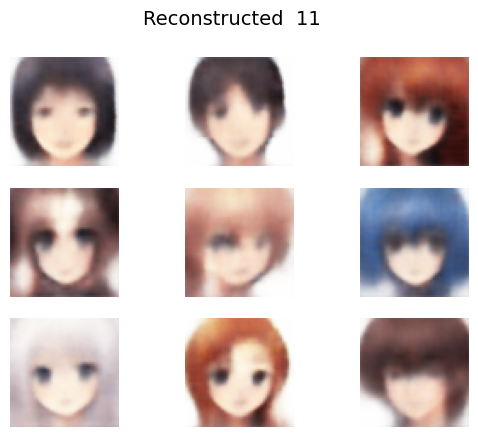


Epoch:  12
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5284
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


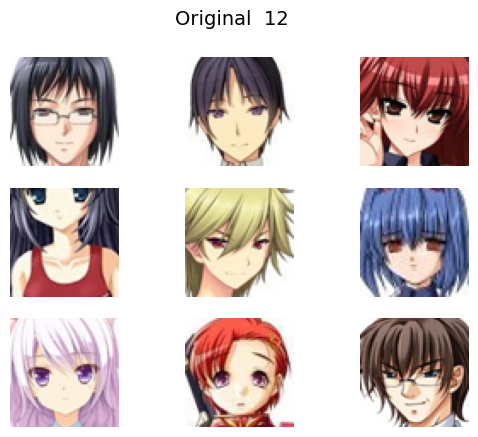

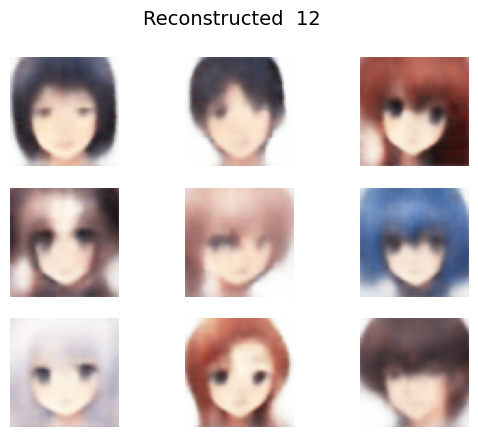


Epoch:  13
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5285
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


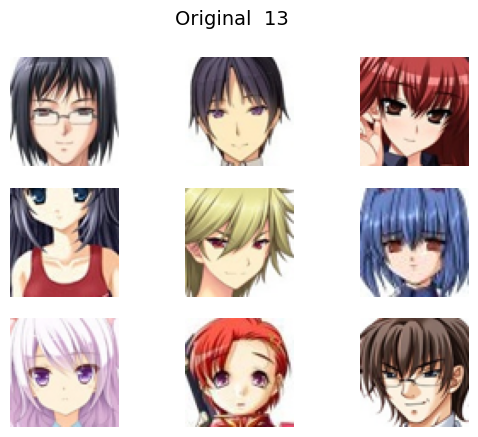

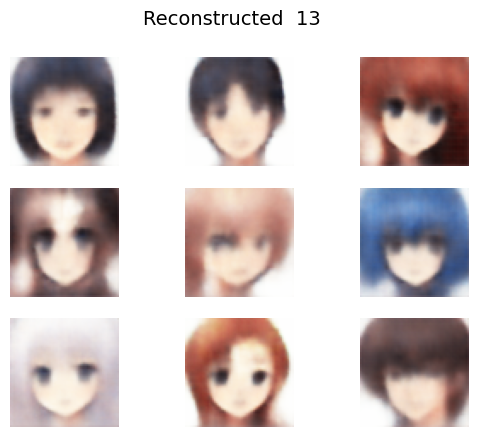


Epoch:  14
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5279
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


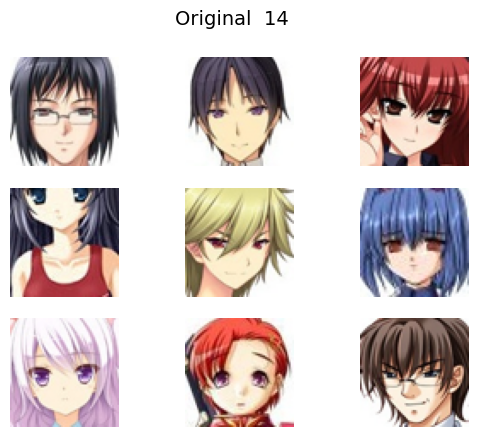

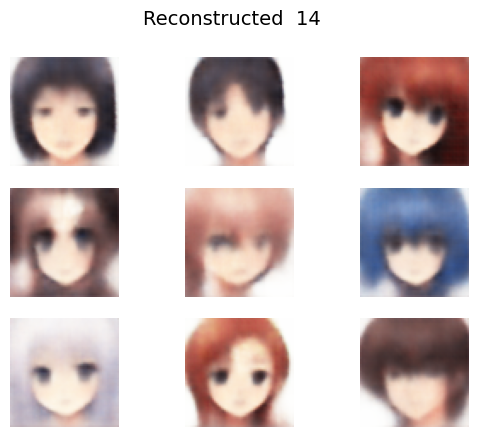


Epoch:  15
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5278
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


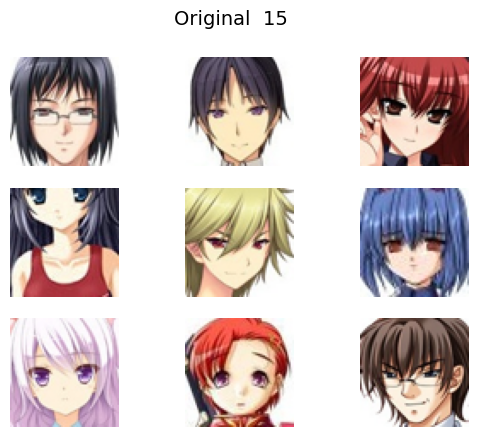

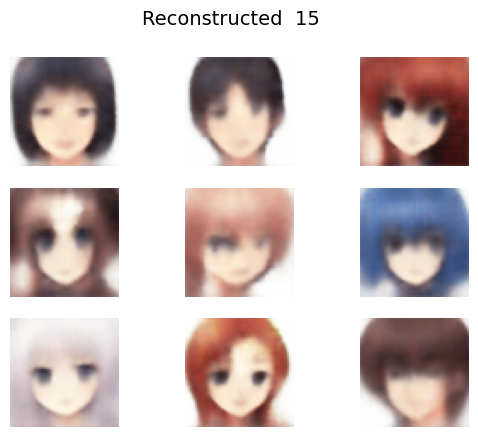


Epoch:  16
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5276
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


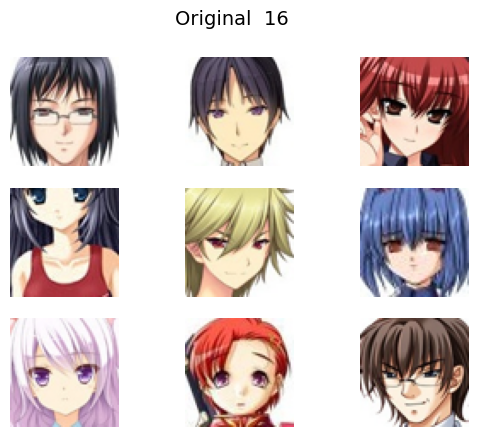

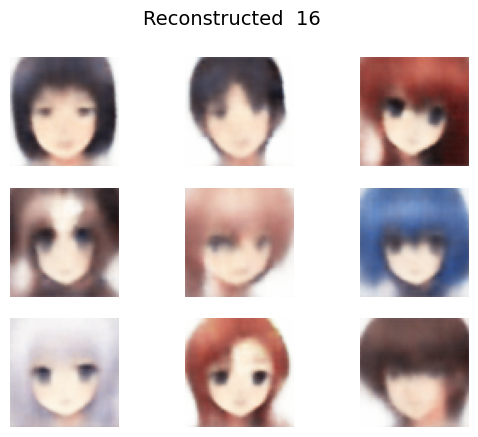


Epoch:  17
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5278
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


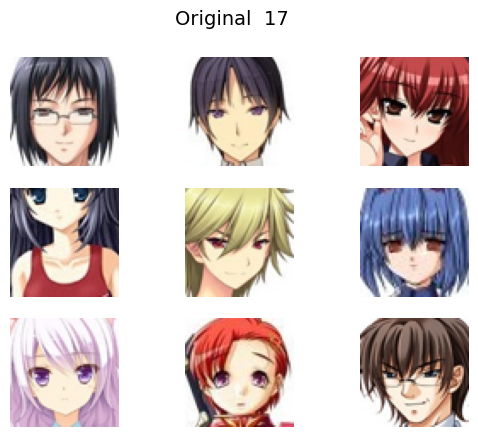

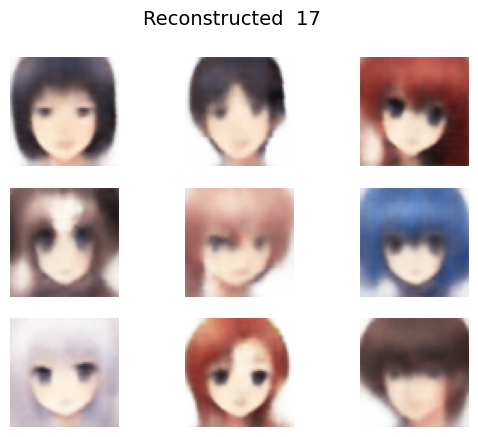


Epoch:  18
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5275
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


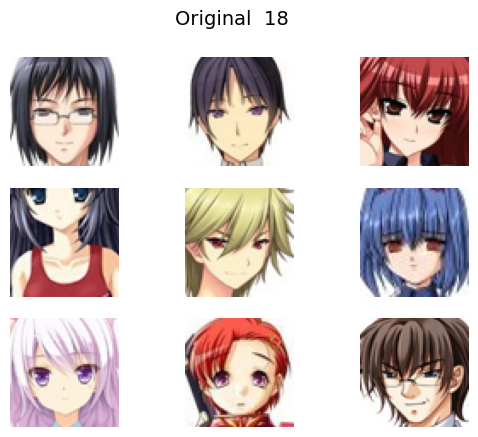

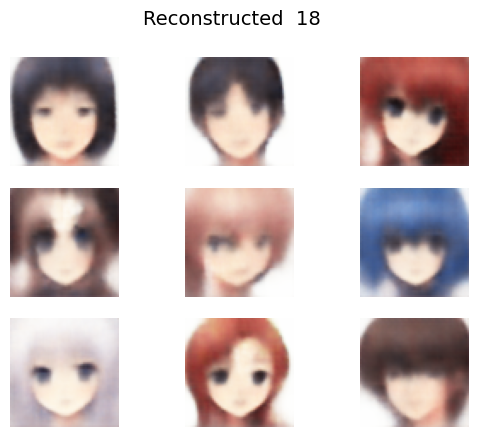


Epoch:  19
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5274
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


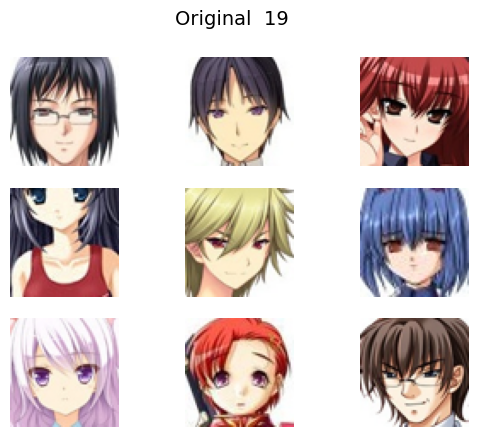

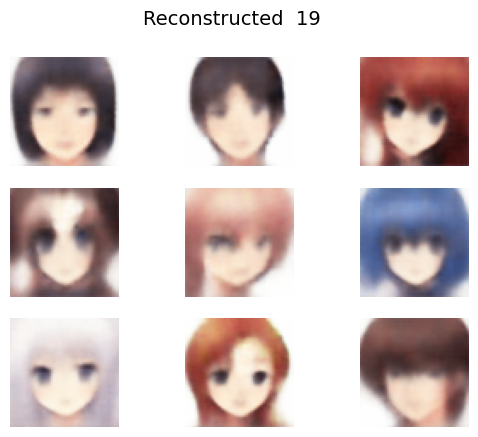


Epoch:  20
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5270
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


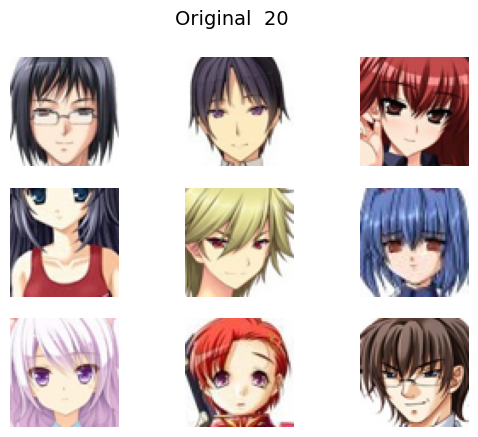

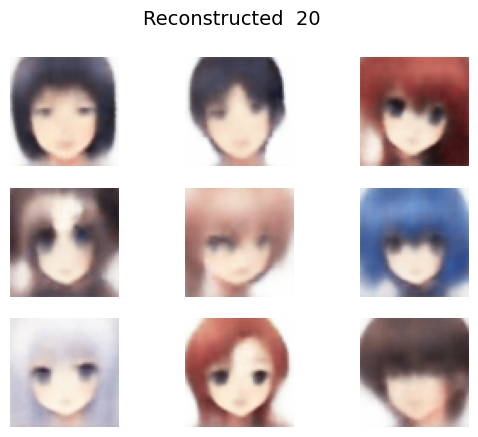


Epoch:  21
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5271
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


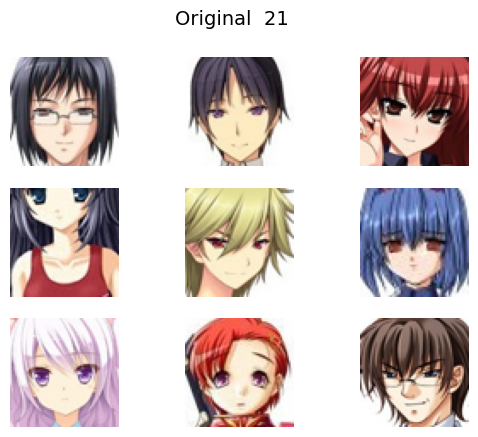

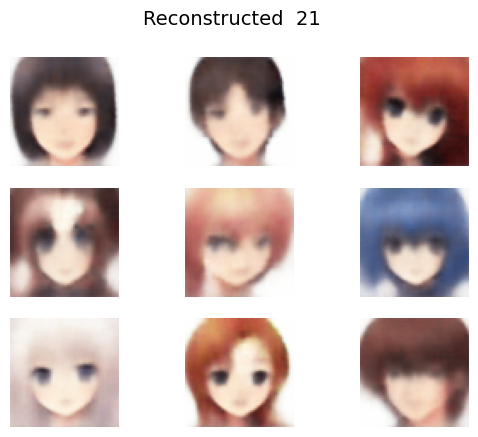


Epoch:  22
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5271
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


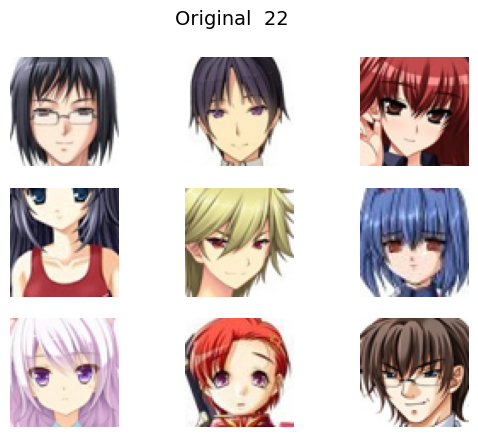

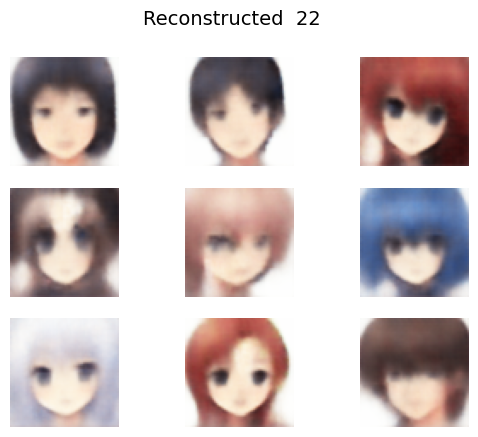


Epoch:  23
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5270
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


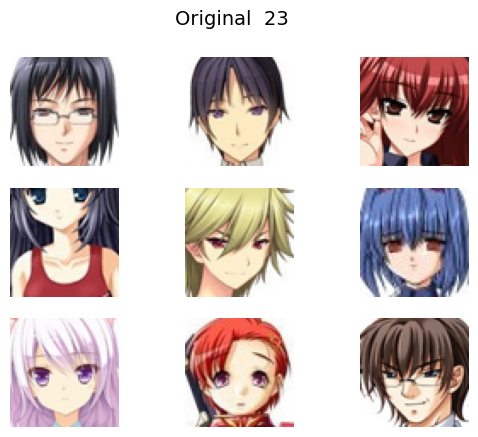

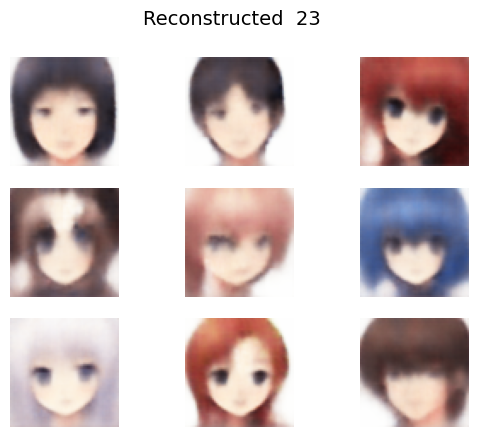


Epoch:  24
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5269
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


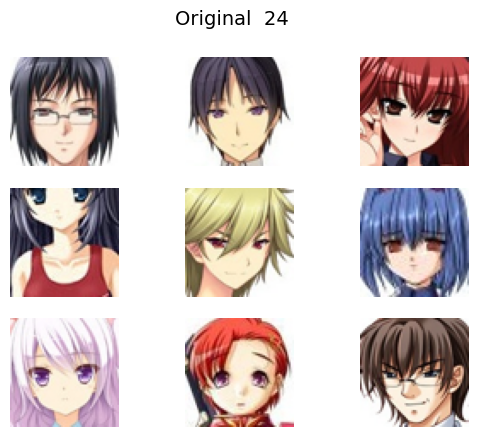

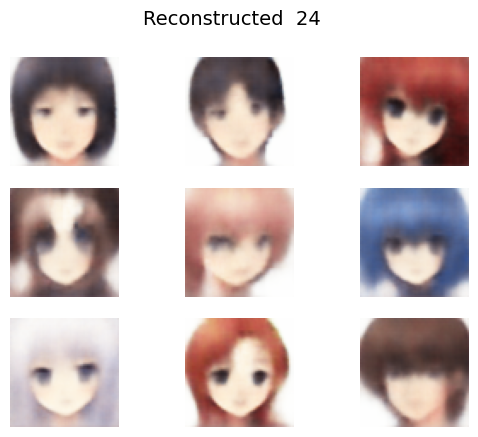


Epoch:  25
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5266
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


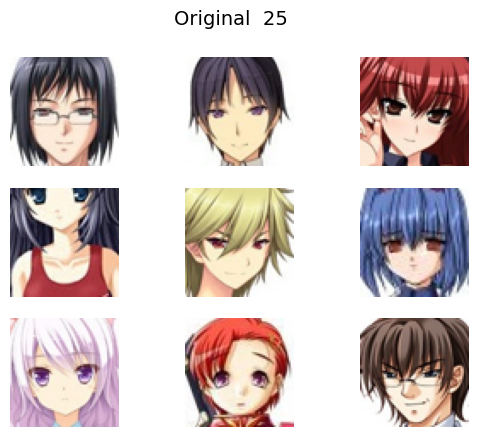

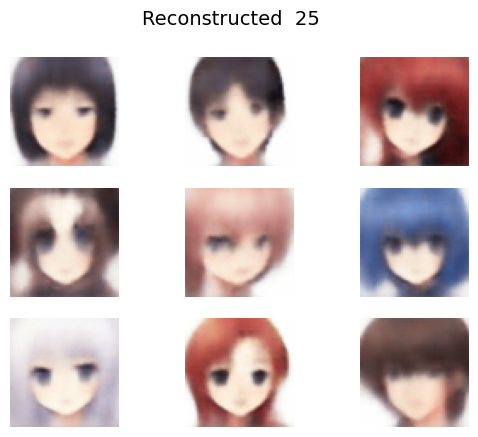


Epoch:  26
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5267
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


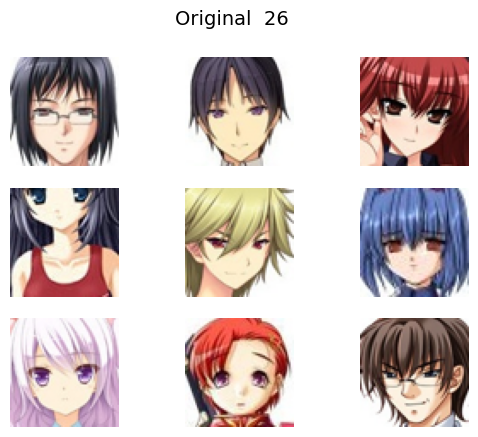

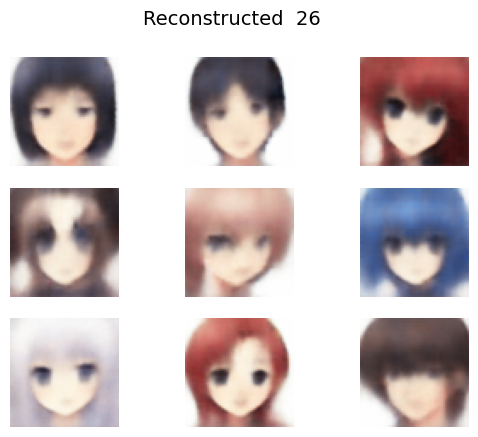


Epoch:  27
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5266
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


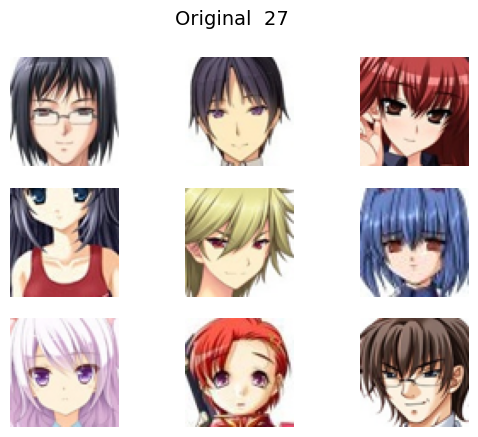

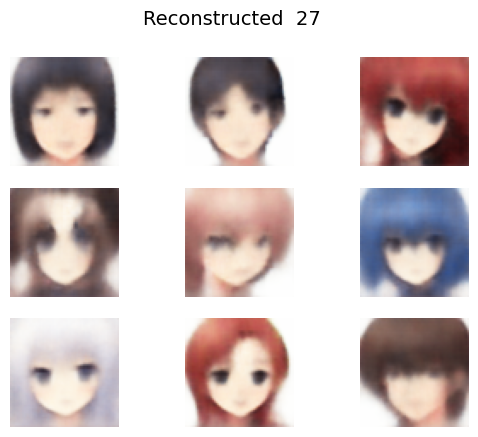


Epoch:  28
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5265
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


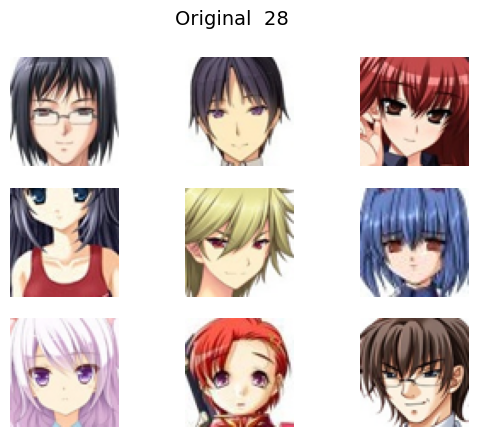

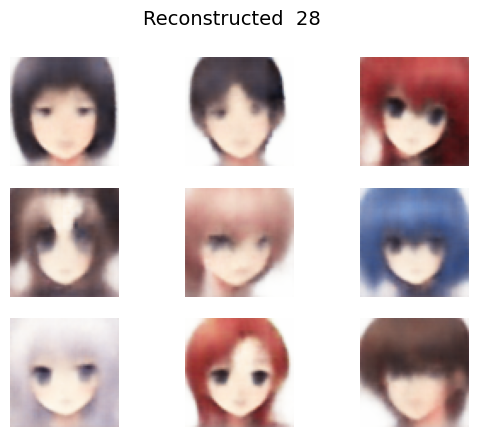


Epoch:  29
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5264
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


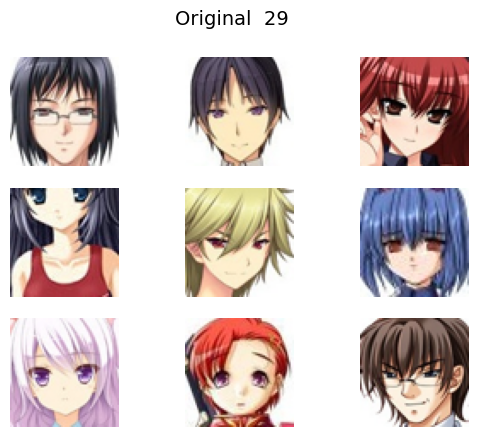

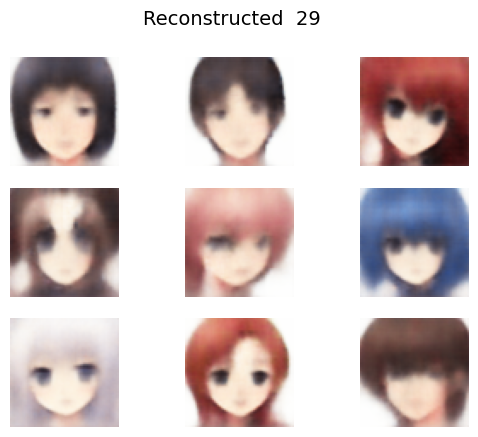


Epoch:  30
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5264
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


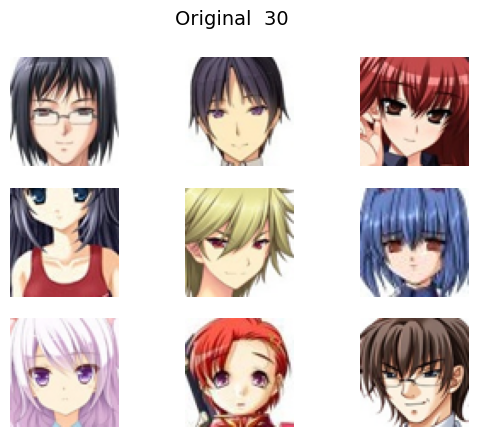

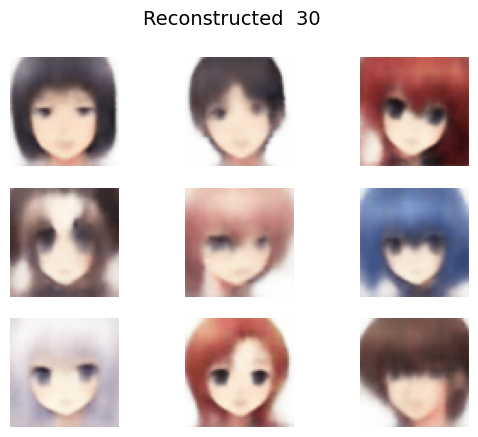


Epoch:  31
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5260
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


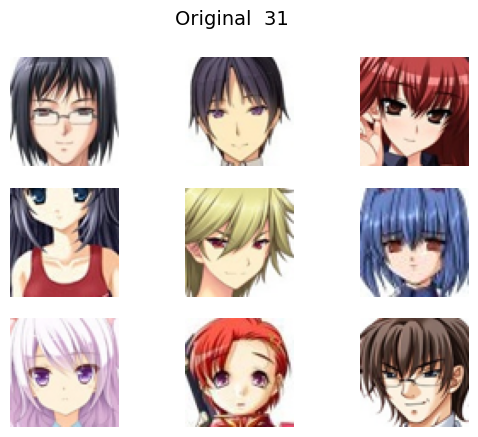

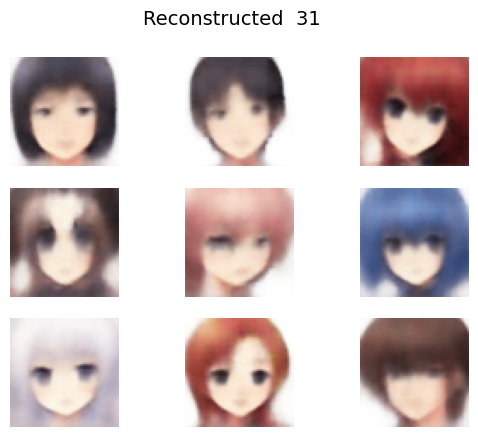


Epoch:  32
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5264
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


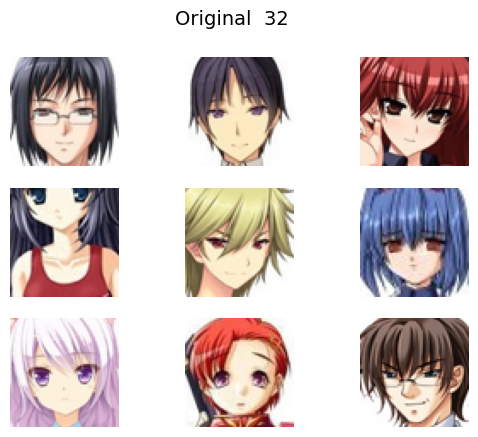

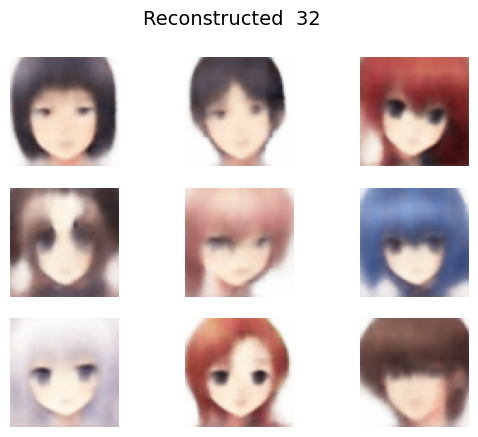


Epoch:  33
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5260
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


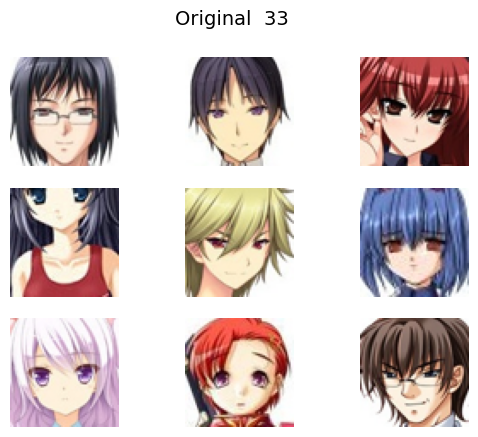

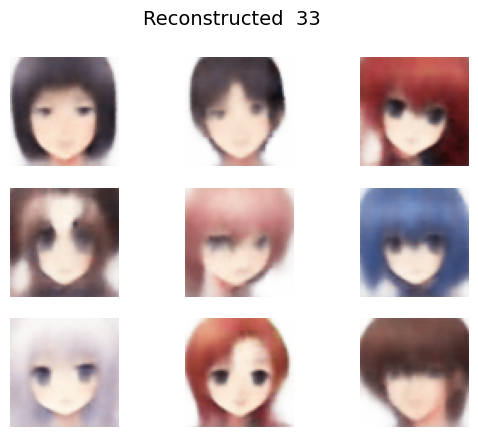


Epoch:  34
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5261
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


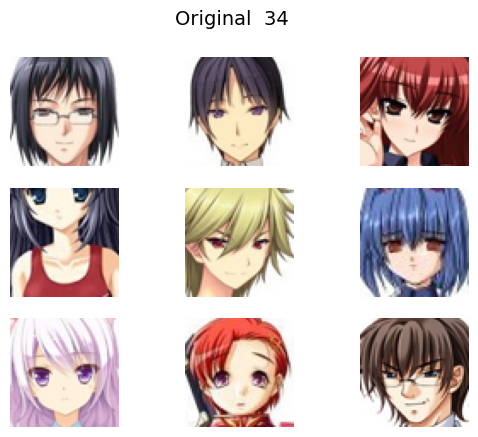

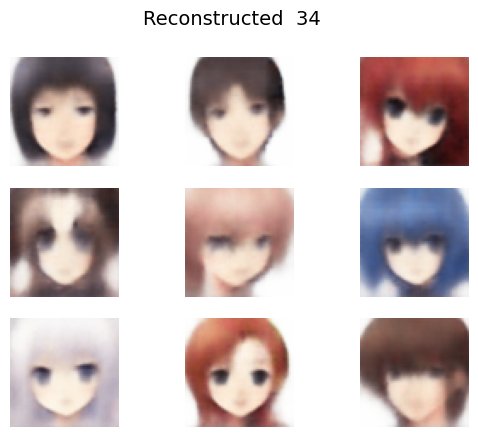


Epoch:  35
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5259
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


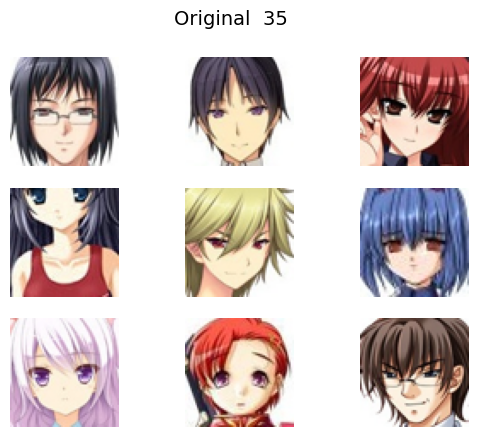

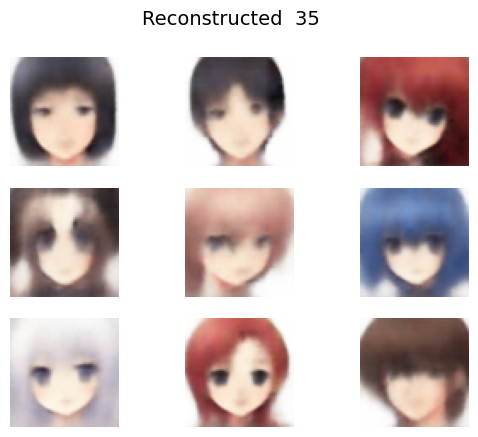


Epoch:  36
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5259
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


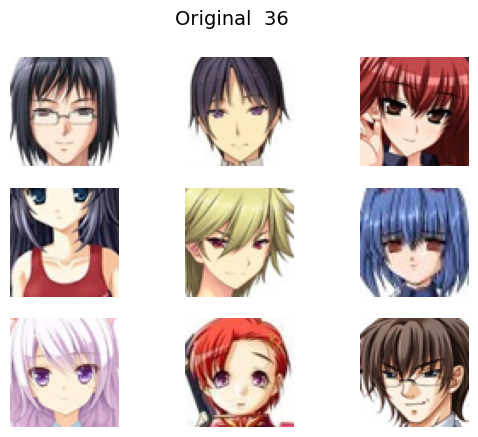

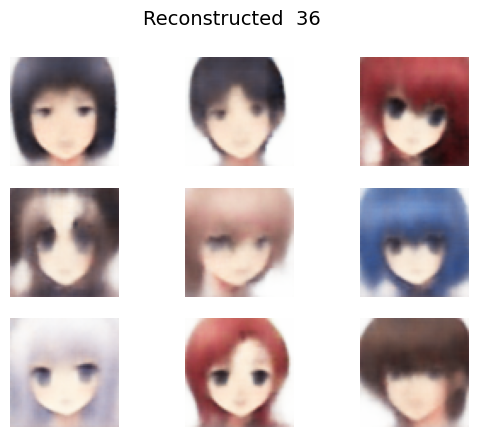


Epoch:  37
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5259
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


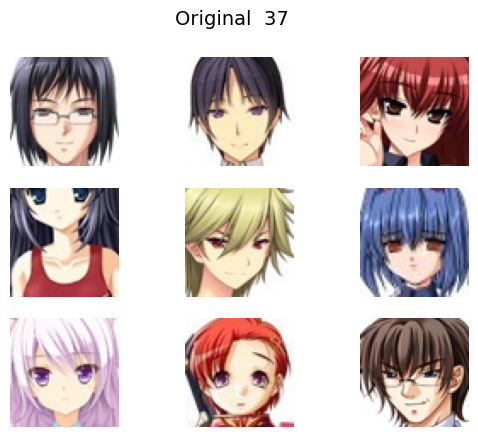

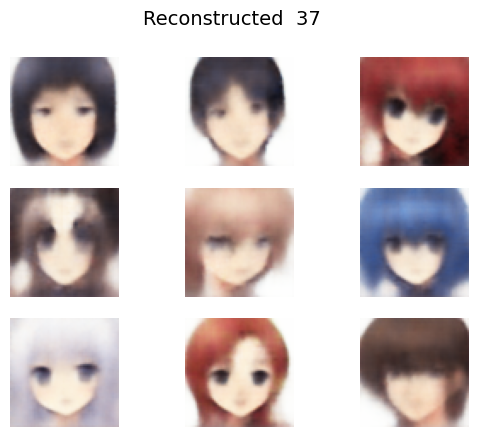


Epoch:  38
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5261
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


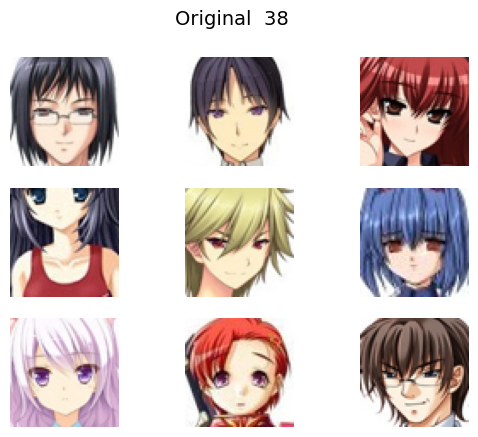

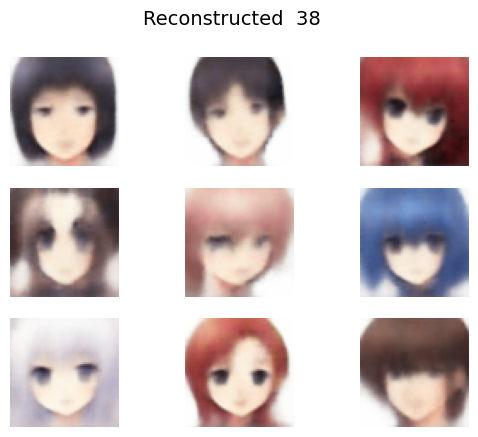


Epoch:  39
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5257
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


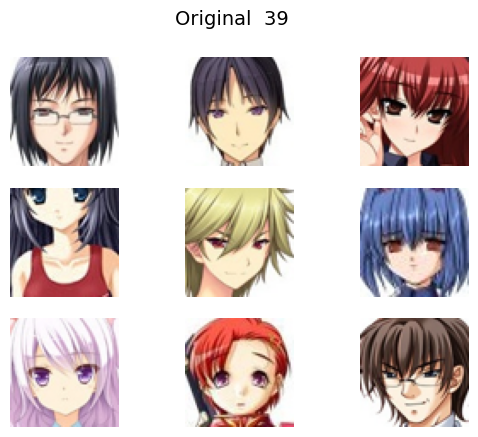

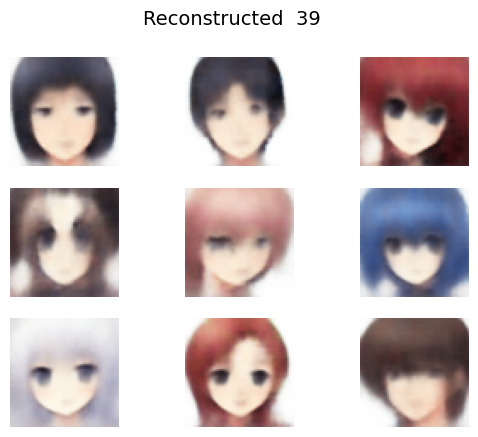


Epoch:  40
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5260
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


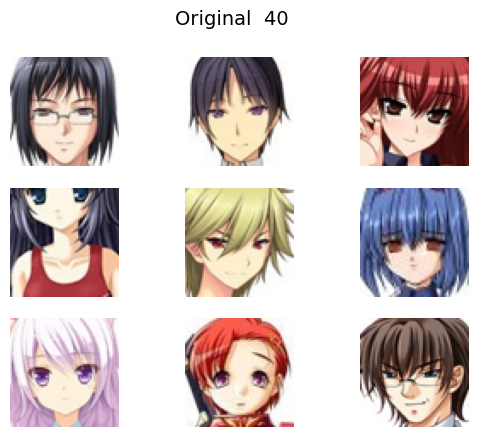

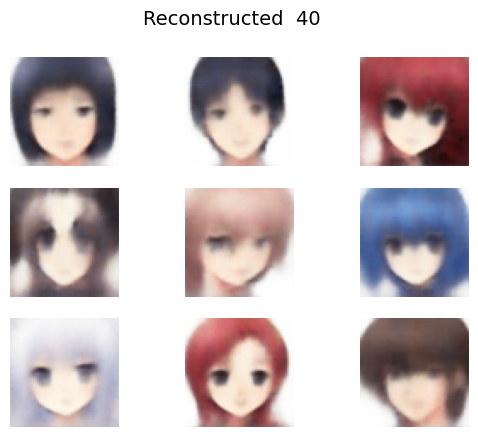


Epoch:  41
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5255
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


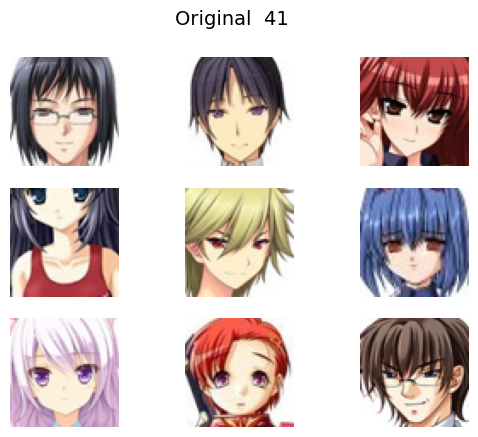

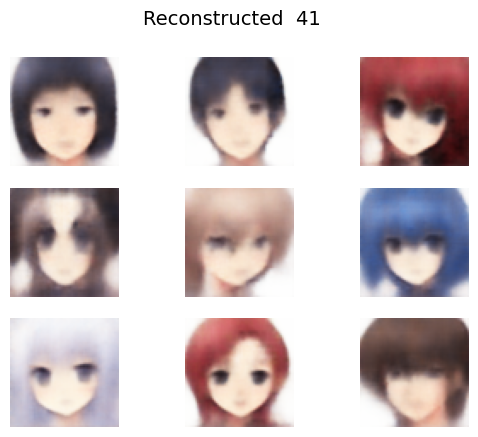


Epoch:  42
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5253
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


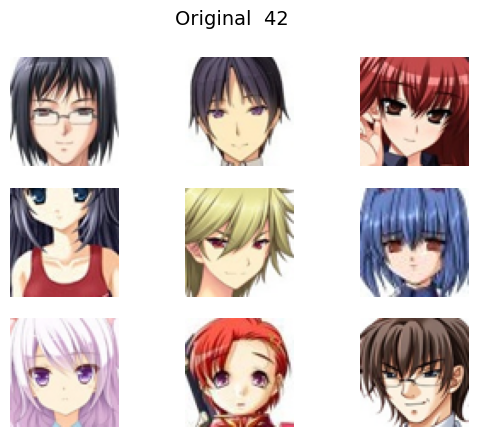

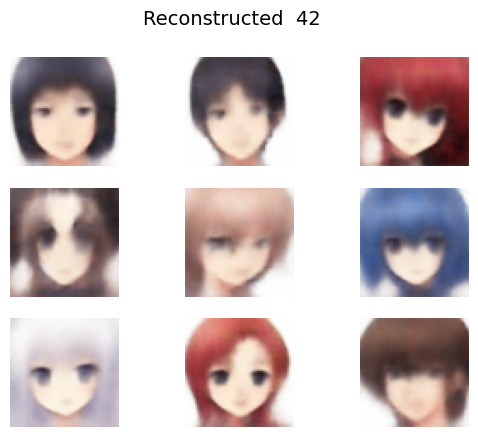


Epoch:  43
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5256
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


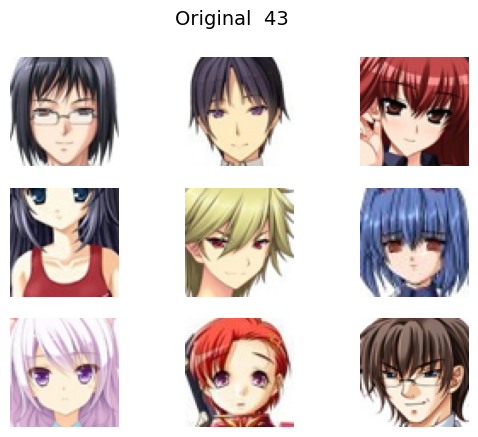

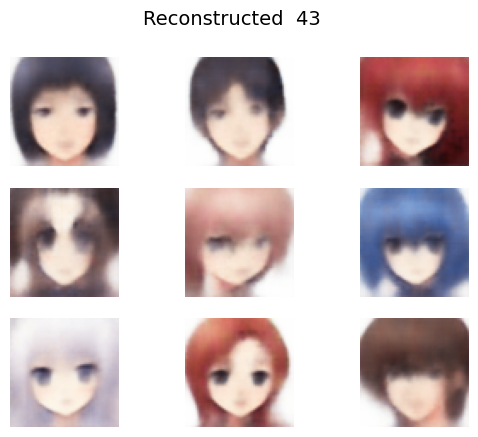


Epoch:  44
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5258
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


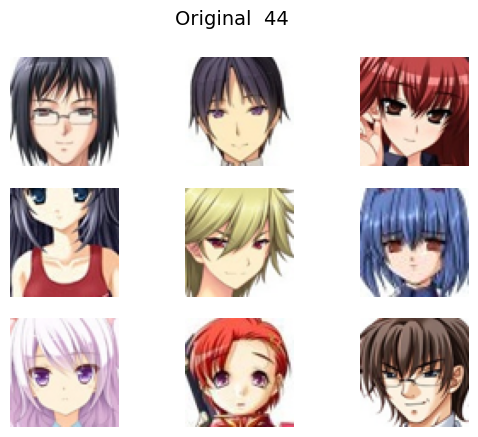

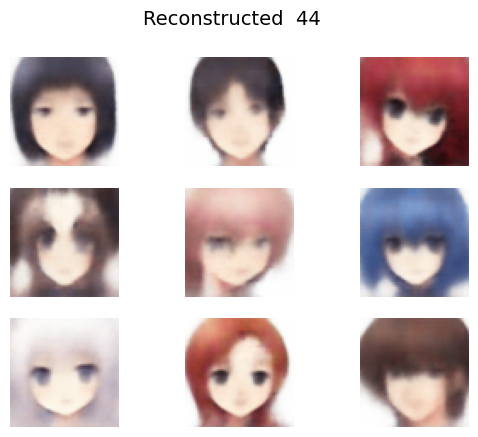


Epoch:  45
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5254
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


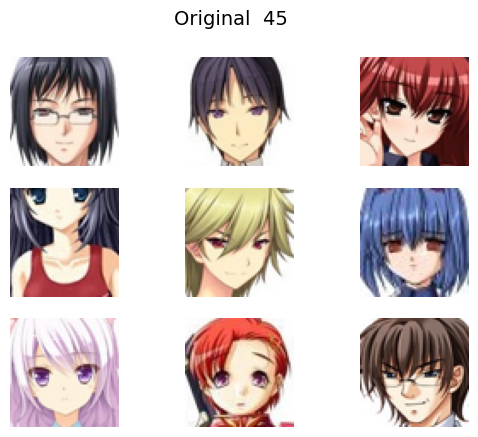

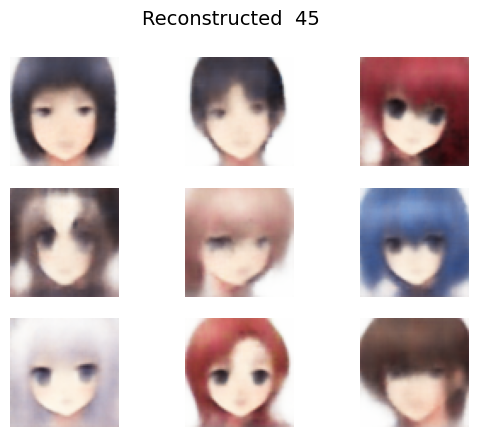


Epoch:  46
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5256
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


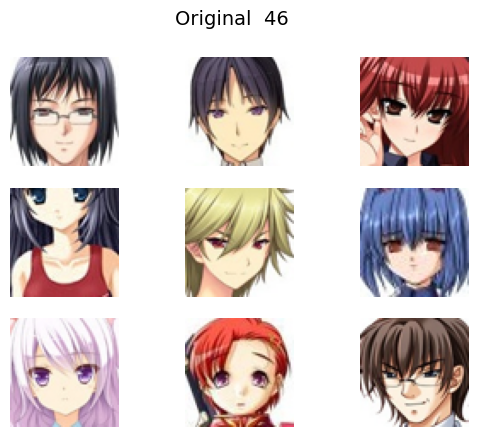

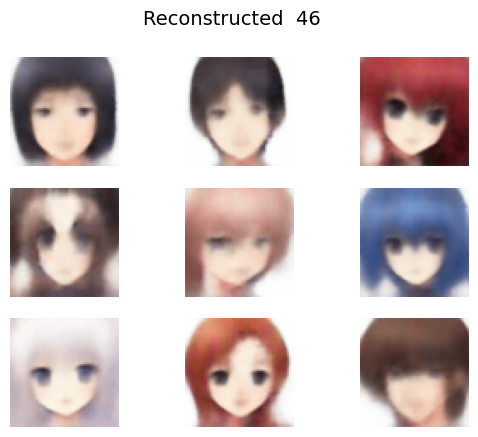


Epoch:  47
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5254
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


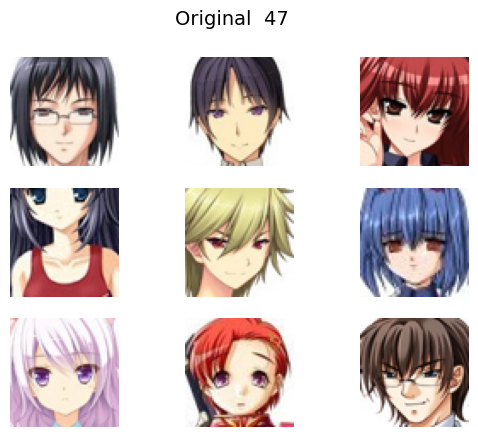

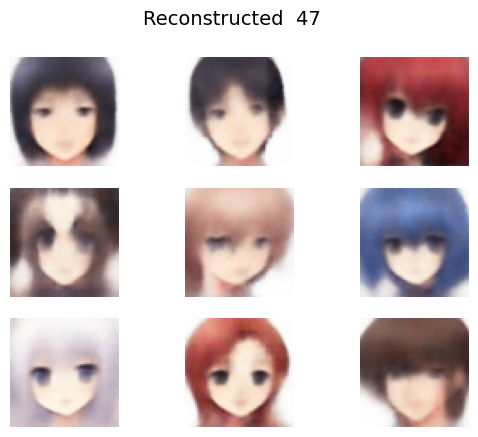


Epoch:  48
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5257
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


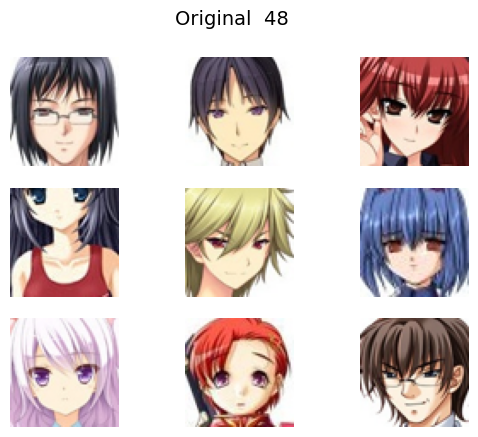

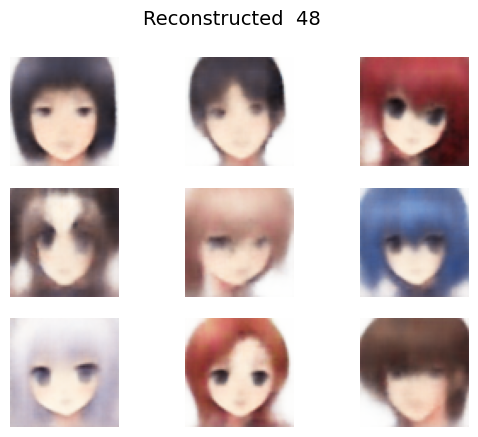


Epoch:  49
994/994 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.5254
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


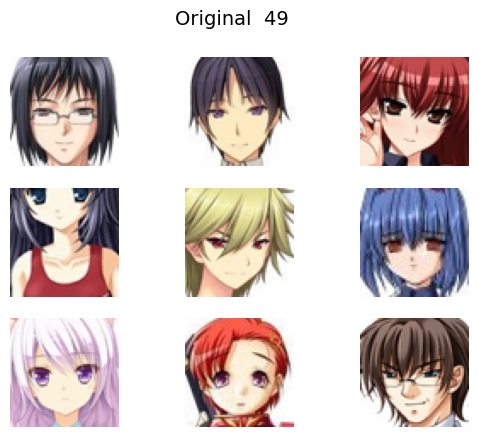

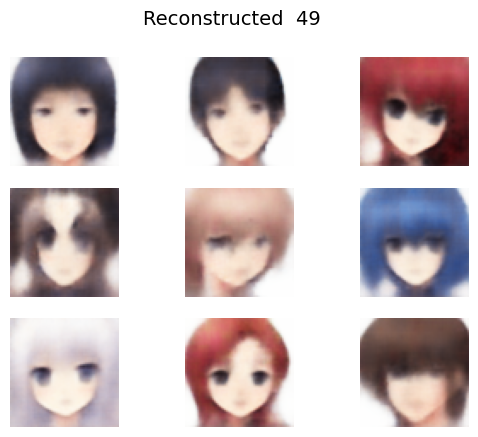

In [ ]:
def build_convolutional_autoencoder(data_shape, latent_dim, filters=128):
    encoder = build_conv_net(in_shape=data_shape, out_shape=latent_dim, filters=filters)
    decoder = build_deconv_net(latent_dim, activation_out='sigmoid', filters=filters)

    # We connect encoder and decoder into a single model
    autoencoder = tf.keras.Sequential([encoder, decoder])

    # Binary crossentropy loss - pairwise comparison between input and output pixels
    autoencoder.compile(loss='binary_crossentropy', optimizer='adam')

    return autoencoder


# Defining the model dimensions and building it
image_size = dataset.shape[1:]
latent_dim = 32
num_filters = 32
cae = build_convolutional_autoencoder(image_size, latent_dim, num_filters)

# Initialize list to store loss values
loss_values = []

## Training the Convolutional autoencoder to reconstruct images
for epoch in range(50):
    print('\nEpoch: ', epoch)

    # Note that (X=y) when training autoencoders!
    # In this case we only care about qualitative performance, we don't split into train/test sets
    history = cae.fit(x=dataset, y=dataset, epochs=1, batch_size=64, verbose=1)

    # Store the loss for the epoch
    loss_values.append(history.history['loss'][0])

    # Visualize original and reconstructed samples
    samples = dataset[:9]
    reconstructed = cae.predict(samples)
    grid_plot(samples, epoch, name='Original', n=3, save=False)
    grid_plot(reconstructed, epoch, name='Reconstructed', n=3, save=False)

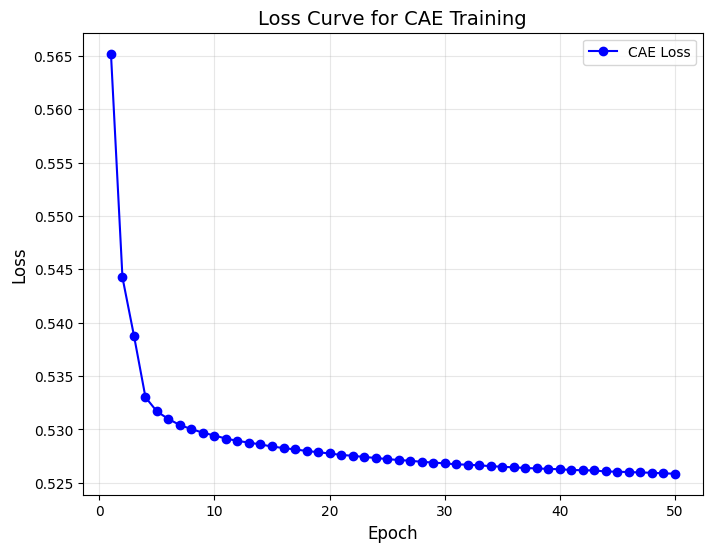

In [ ]:
plt.figure(figsize=(8, 6))
plt.plot(range(1, len(loss_values) + 1), loss_values, marker='o', color='blue', label='CAE Loss')
plt.title("Loss Curve for CAE Training", fontsize=14)
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("Loss", fontsize=12)
plt.grid(alpha=0.3)
plt.legend(fontsize=10)
plt.savefig("cae_loss_curve.png", dpi=300, bbox_inches='tight')
plt.show()

### Interpolation

Interpolation involves generating intermediate latent vectors between two points in the latent space and decoding them to visualize how the model transitions between these two points.

In [ ]:
from sklearn.manifold import TSNE

def visualize_latent_space_with_tsne(encoder, dataset, n_samples=500):
    """
    Visualizes the latent space of the encoder using t-SNE with image overlays.

    Args:
        encoder: The encoder model to extract latent representations.
        dataset: The dataset to visualize.
        n_samples: Number of samples to visualize.
    """!pip install numpy==1.23.5

16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 29ms/step


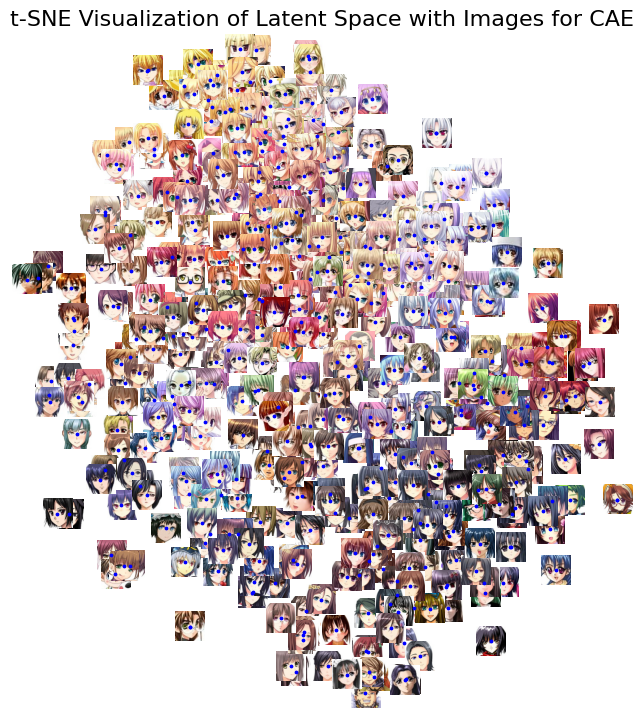

In [ ]:
# Extract the encoder from the CAE model
encoder = cae.layers[0]  # Encoder is the first part of the CAE model

# Visualize the latent space
visualize_latent_space_with_tsne(encoder, dataset)

---
---


## 2. 2. Variational Autoencoders (VAEs)

<img src="https://lilianweng.github.io/lil-log/assets/images/vae-gaussian.png" width="500">

#### Encoder network
This defines the approximate posterior distribution, which takes as input an observation and outputs a set of parameters for specifying the conditional distribution of the latent representation. In this example, we simply model the distribution as a diagonal Gaussian, and the network outputs the mean and log-variance parameters of a factorized Gaussian. We output log-variance instead of the variance directly for numerical stability.

#### Decoder network
This defines the conditional distribution of the observation $z$, which takes a latent sample $z$ as input and outputs the parameters for a conditional distribution of the observation. We model the latent distribution prior  as a unit Gaussian.

#### Reparameterization trick
To generate a sample  for the decoder during training, we can sample from the latent distribution defined by the parameters outputted by the encoder, given an input observation $z$. However, this sampling operation creates a bottleneck because backpropagation cannot flow through a random node.

To address this, we use a reparameterization trick. In our example, we approximate  using the decoder parameters and another parameter  as follows:

$$z = \mu + \sigma\epsilon$$

where $\mu$ and $\sigma$  represent the mean and standard deviation of a Gaussian distribution respectively. They can be derived from the decoder output. The  can be thought of as a random noise used to maintain stochasticity of $z$. We generate  from a standard normal distribution.

The latent variable  is now generated by a function of $\mu$ and $\sigma$ which would enable the model to backpropagate gradients in the encoder through $\mu$ and $\sigma$ respectively, while maintaining stochasticity through $\epsilon$.

#### Implementation

You can see how this trick is implemented below by creating a custom layer by sublassing tf.keras.layers.Layer.
It is then connected to the output of the original encoder architecture and an additional [KL](https://en.wikipedia.org/wiki/Kullback–Leibler_divergence) loss term is introduced.


In [ ]:
class Sampling(tf.keras.layers.Layer):
    """
    Custom layer for the variational autoencoder
    It takes two vectors as input - one for means and other for variances of the latent variables described by a multimodal gaussian
    Its output is a latent vector randomly sampled from this distribution
    """
    def call(self, inputs):
        z_mean, z_var = inputs
        batch = tf.shape(z_mean)[0]
        dim = tf.shape(z_mean)[1]
        epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
        return z_mean + tf.exp(0.5 * z_var) * epsilon

def build_vae(data_shape, latent_dim, filters=128):

    # Building the encoder - starts with a simple downsampling convolutional network
    encoder = build_conv_net(data_shape, latent_dim*2, filters=filters)

    # Adding special sampling layer that uses the reparametrization trick
    z_mean = Dense(latent_dim)(encoder.output)
    z_var = Dense(latent_dim)(encoder.output)
    z = Sampling()([z_mean, z_var])

    # Connecting the two encoder parts
    encoder = tf.keras.Model(inputs=encoder.input, outputs=z)

    # Defining the decoder which is a regular upsampling deconvolutional network
    decoder = build_deconv_net(latent_dim, activation_out='sigmoid', filters=filters)
    vae = tf.keras.Model(inputs=encoder.input, outputs=decoder(z))

    # Define a custom layer for the KL loss calculation
    class KLLossLayer(tf.keras.layers.Layer):
        def call(self, inputs):
            z_mean, z_var = inputs
            kl_loss = -0.5 * tf.reduce_sum(z_var - tf.square(z_mean) - tf.exp(z_var) + 1)
            # Add the KL loss to the model's losses
            self.add_loss(kl_loss / tf.cast(tf.keras.backend.prod(data_shape), tf.float32))
            return inputs  # Pass through the inputs unchanged

    # Apply the custom layer to z_mean and z_var
    _, _ = KLLossLayer()([z_mean, z_var])

    vae.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3), loss='binary_crossentropy')

    return encoder, decoder, vae

Model: "Encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_3 (InputLayer)           │ (None, 64, 64, 3)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ enc_input (Conv2D)                   │ (None, 32, 32, 64)          │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, 16, 16, 64)          │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 8, 8, 64)            │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_6 (Conv2D)                    │ (None, 4, 4, 64)            │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_7 (Conv2D)                    │ (None, 2, 2, 64)            │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ enc_output (Dense)                   │ (None, 128)                 │          32,896 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 182,400 (712.50 KB)

 Trainable params: 182,400 (712.50 KB)

 Non-trainable params: 0 (0.00 B)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "Decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_4 (InputLayer)           │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dec_input (Dense)                    │ (None, 1024)                │          66,560 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape_1 (Reshape)                  │ (None, 4, 4, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_4 (Conv2DTranspose) │ (None, 8, 8, 64)            │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_5 (Conv2DTranspose) │ (None, 16, 16, 64)          │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_6 (Conv2DTranspose) │ (None, 32, 32, 64)          │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_7 (Conv2DTranspose) │ (None, 64, 64, 64)          │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dec_output (Conv2D)                  │ (None, 64, 64, 3)           │           1,731 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 216,003 (843.76 KB)

 Trainable params: 216,003 (843.76 KB)

 Non-trainable params: 0 (0.00 B)


Epoch 1/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 51s 6ms/step - loss: 0.5612


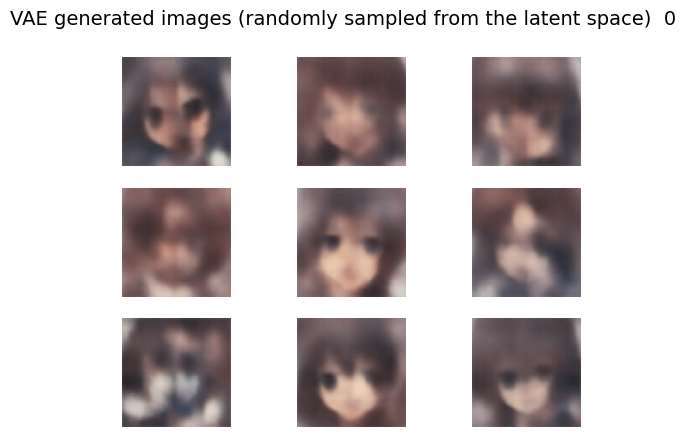


Epoch 2/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5241


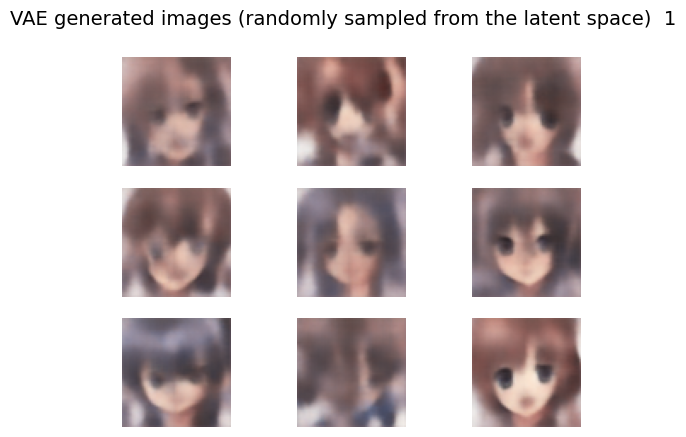


Epoch 3/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5196


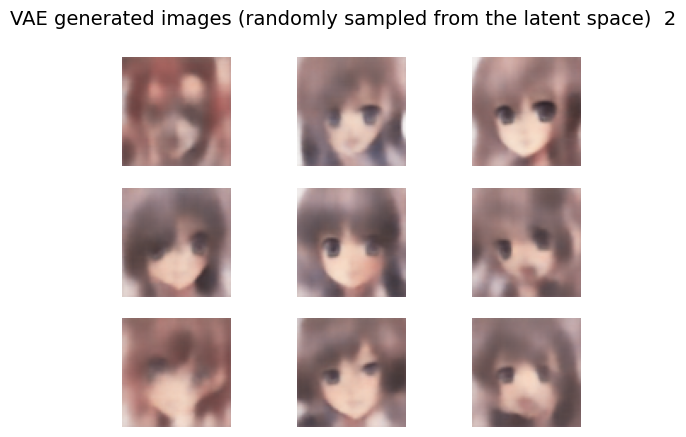


Epoch 4/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5180


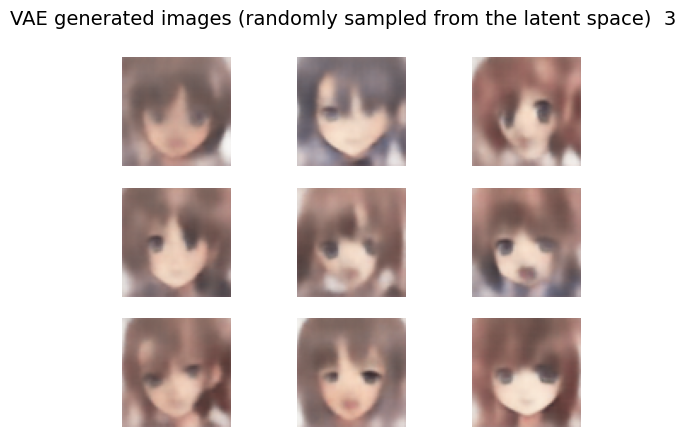


Epoch 5/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5164


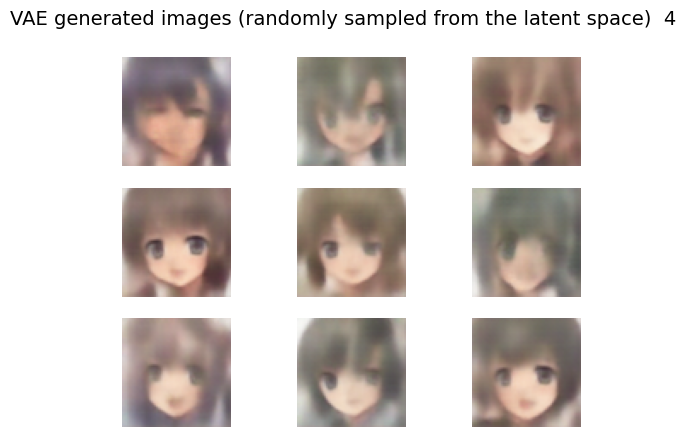


Epoch 6/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5146


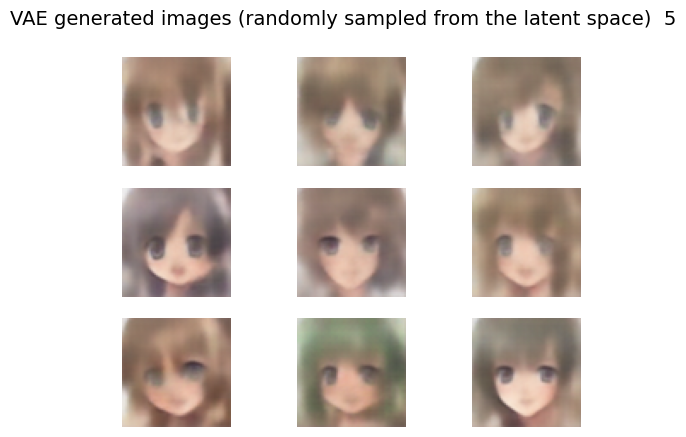


Epoch 7/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5141


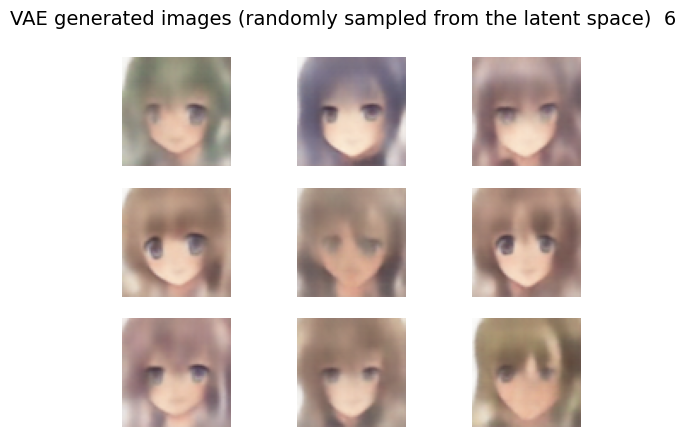


Epoch 8/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5137


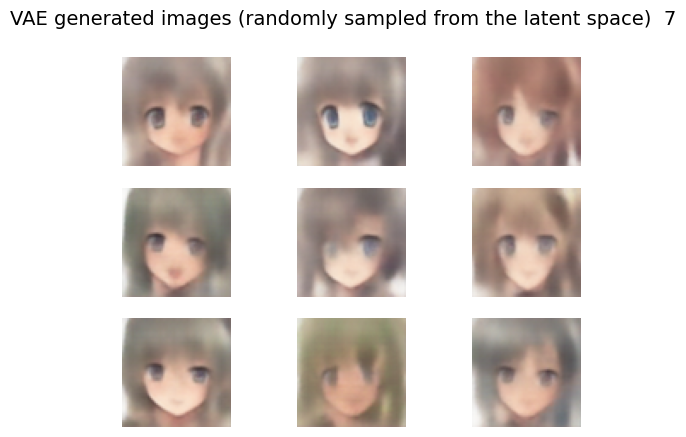


Epoch 9/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5135


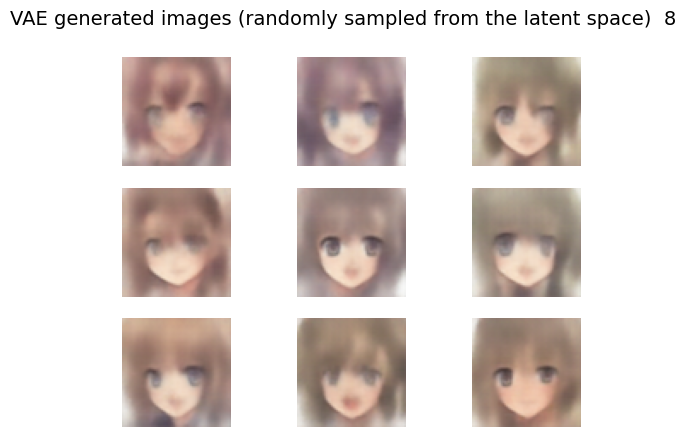


Epoch 10/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5135


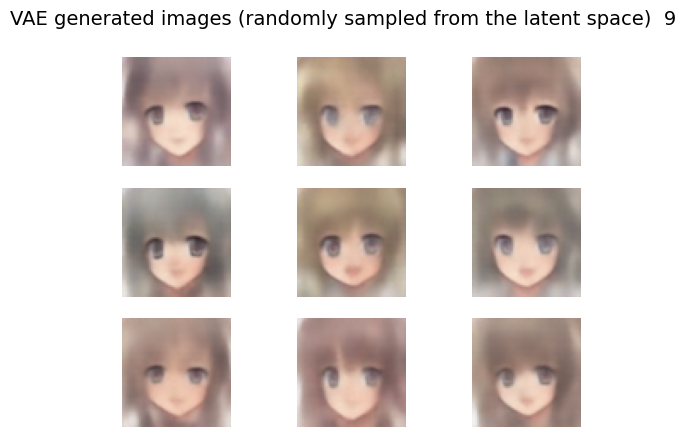


Epoch 11/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5129


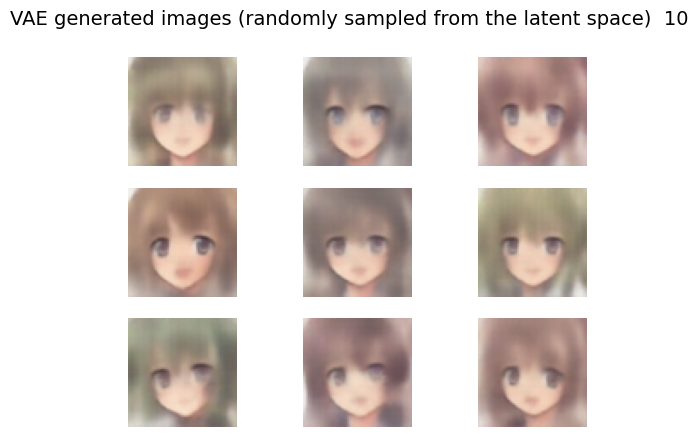


Epoch 12/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5135


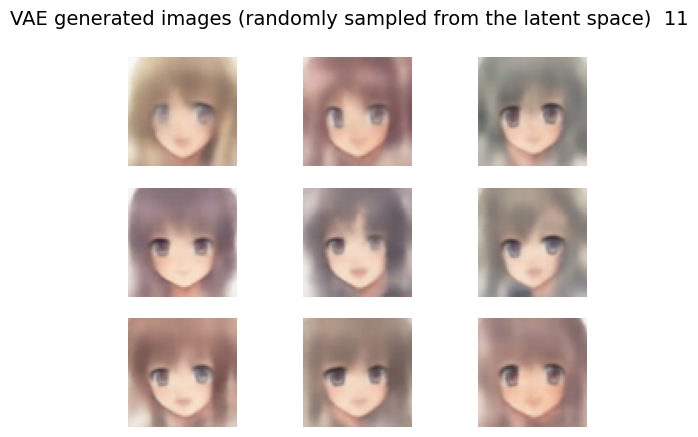


Epoch 13/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5128


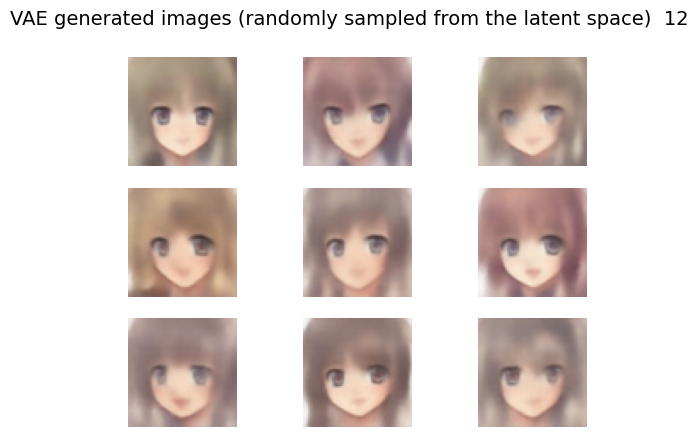


Epoch 14/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5127


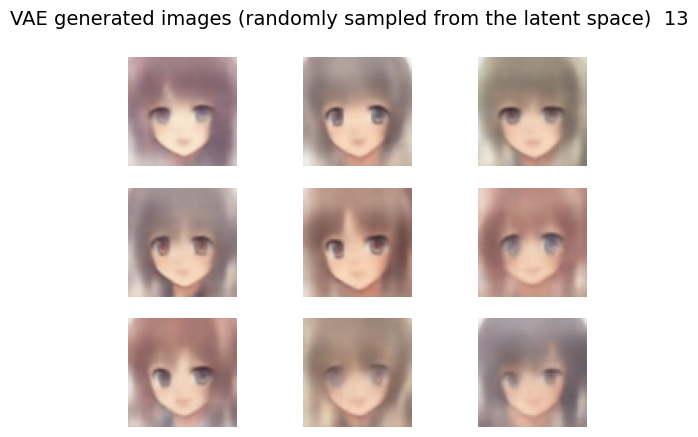


Epoch 15/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5125


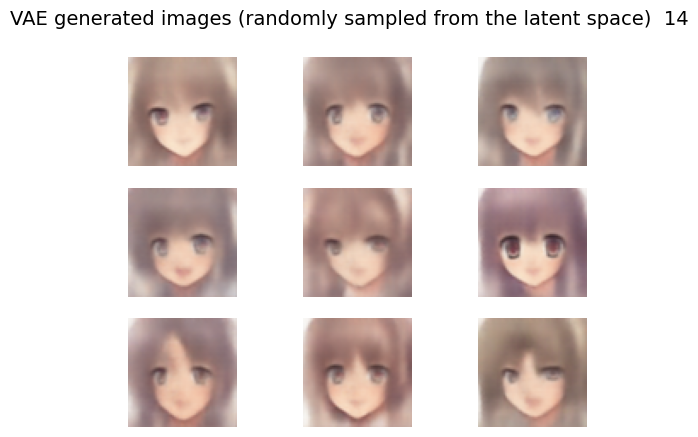


Epoch 16/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 42s 5ms/step - loss: 0.5126


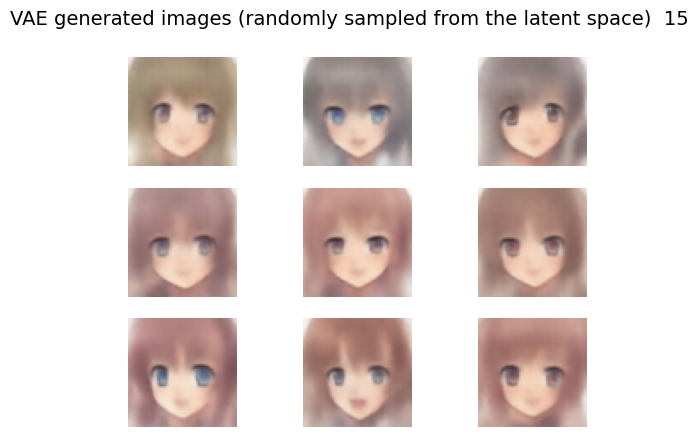


Epoch 17/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5126


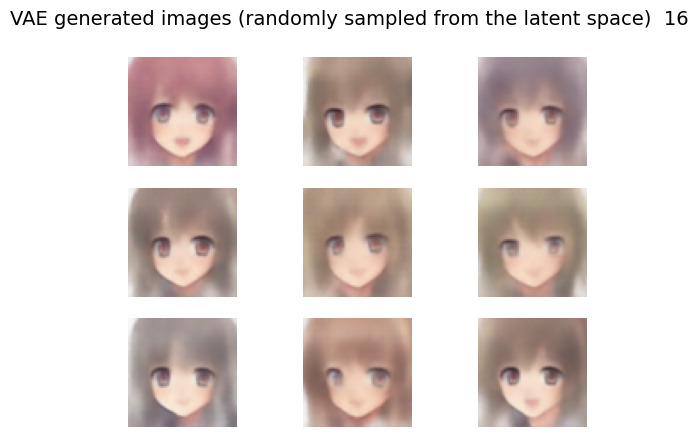


Epoch 18/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5125


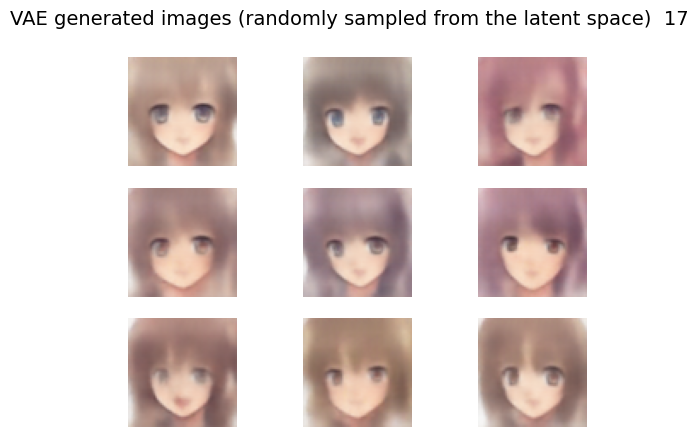


Epoch 19/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5127


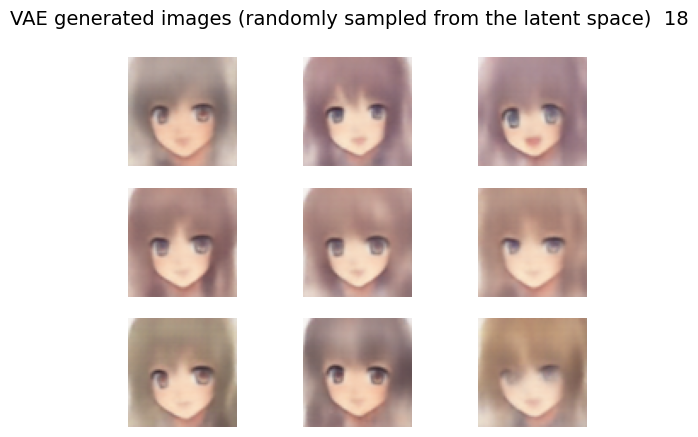


Epoch 20/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5123


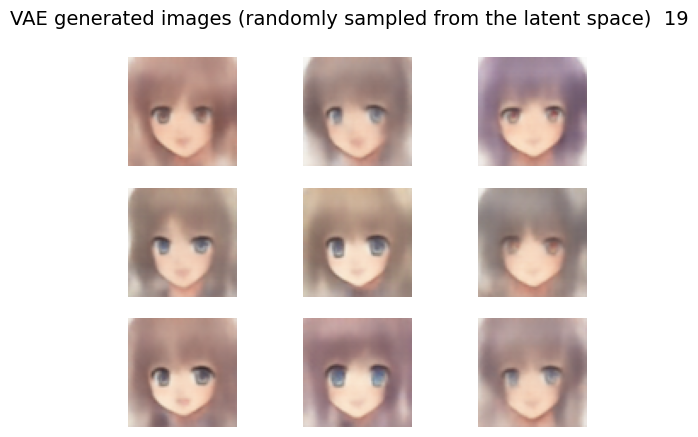


Epoch 21/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5120


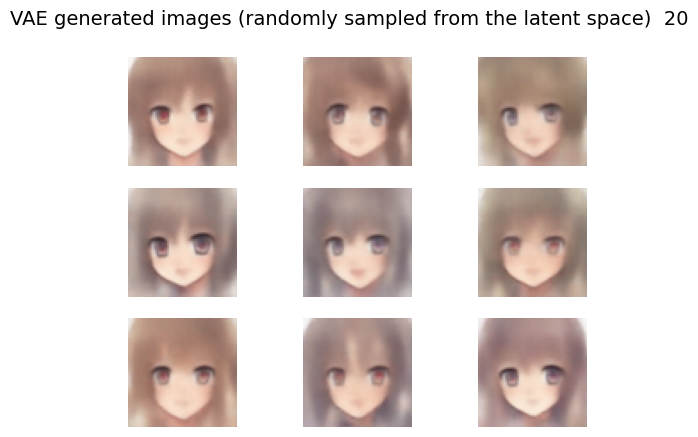


Epoch 22/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5116


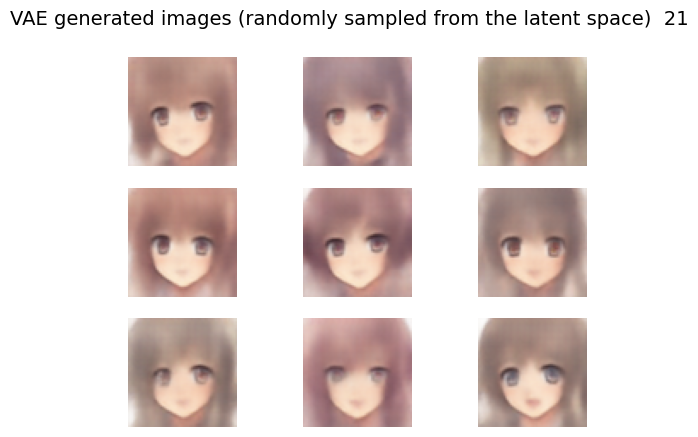


Epoch 23/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5119


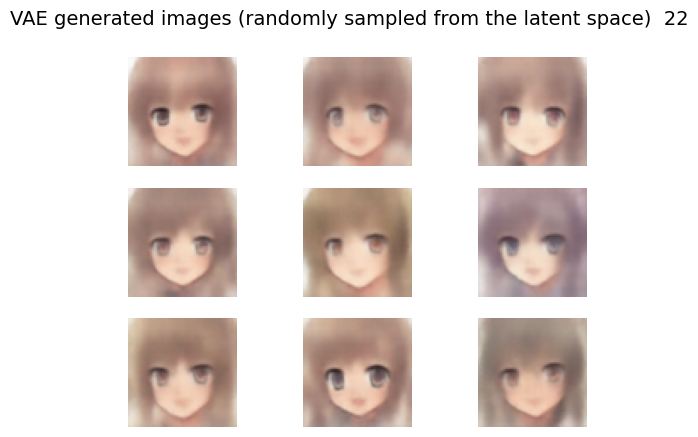


Epoch 24/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5122


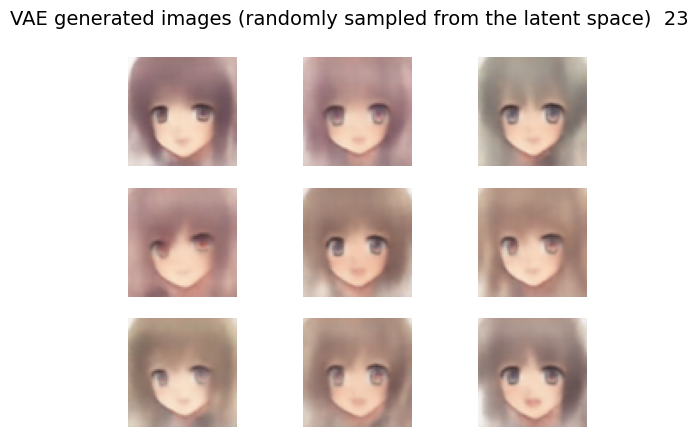


Epoch 25/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5119


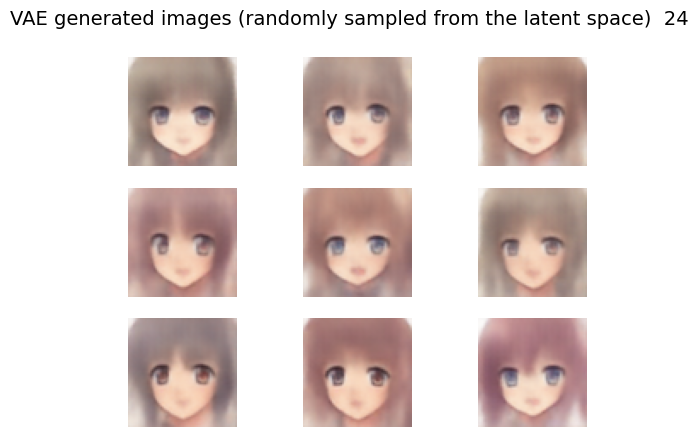


Epoch 26/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5119


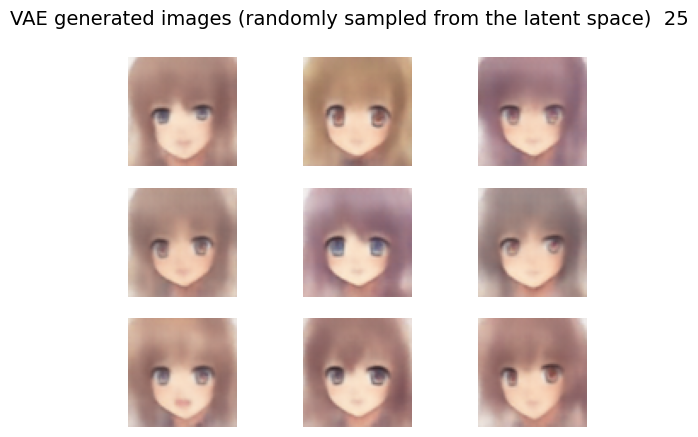


Epoch 27/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5118


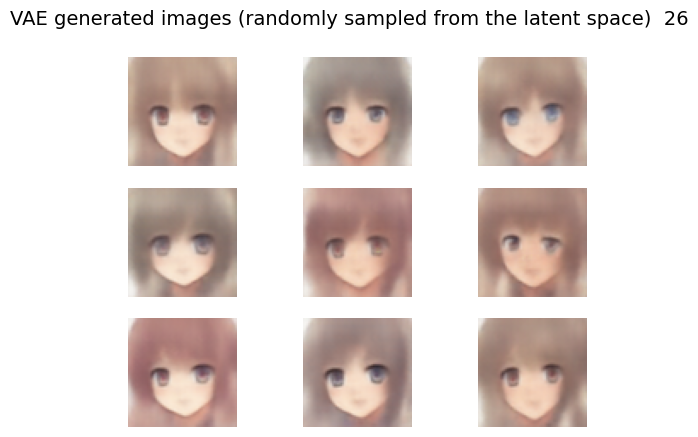


Epoch 28/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5122


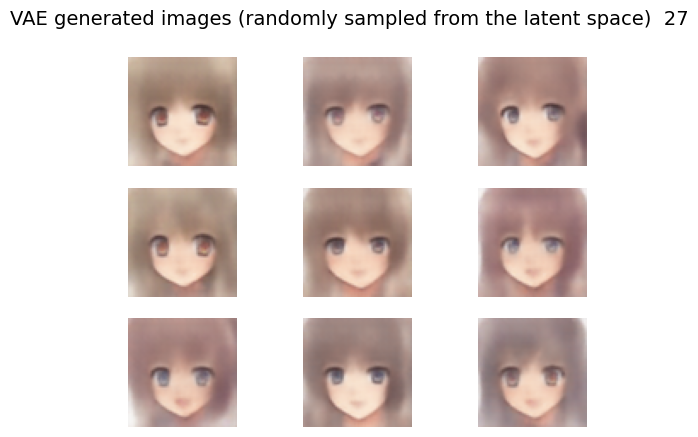


Epoch 29/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5118


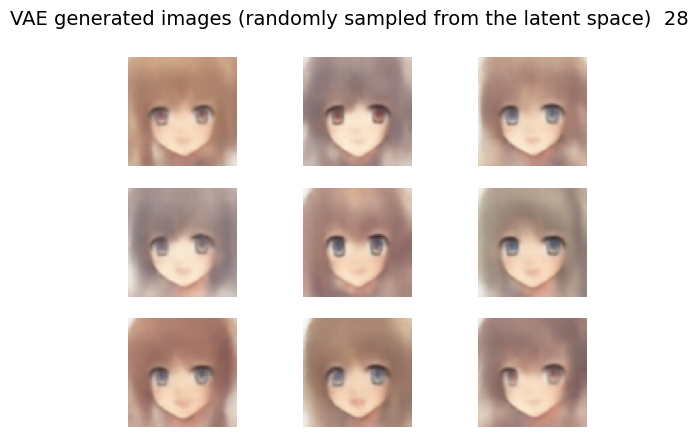


Epoch 30/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5117


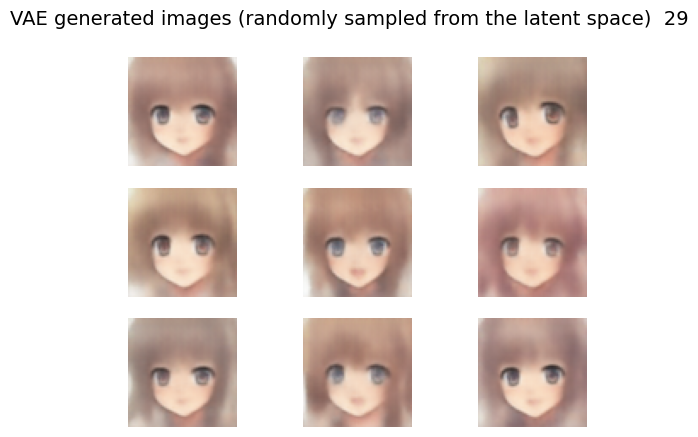


Epoch 31/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5118


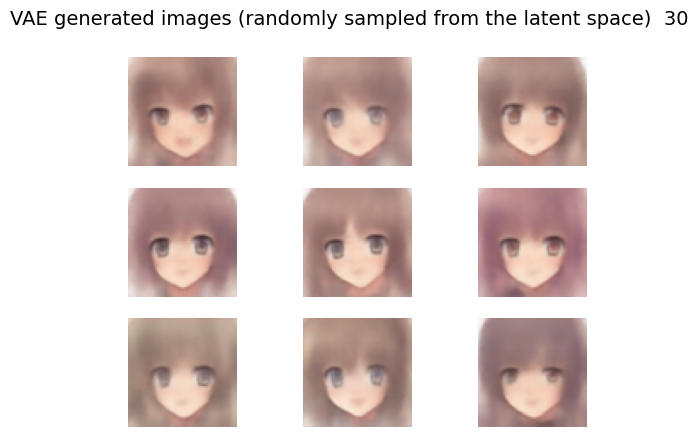


Epoch 32/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5114


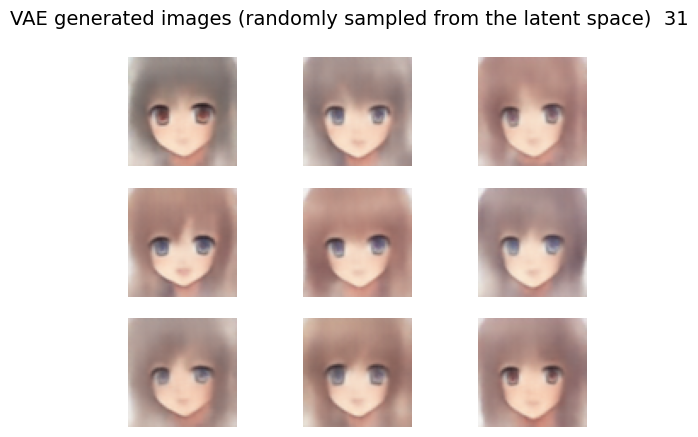


Epoch 33/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5118


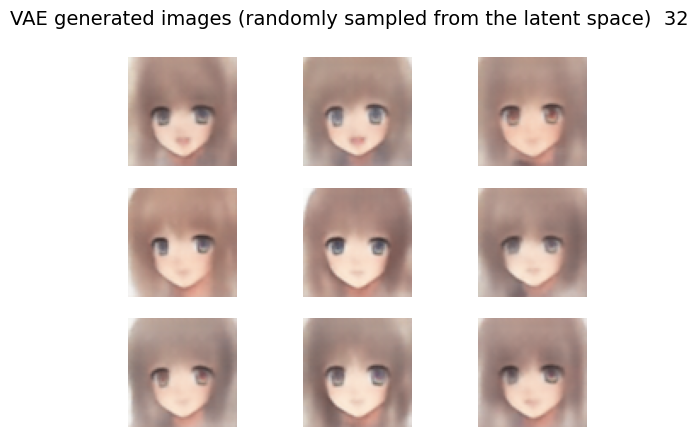


Epoch 34/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5118


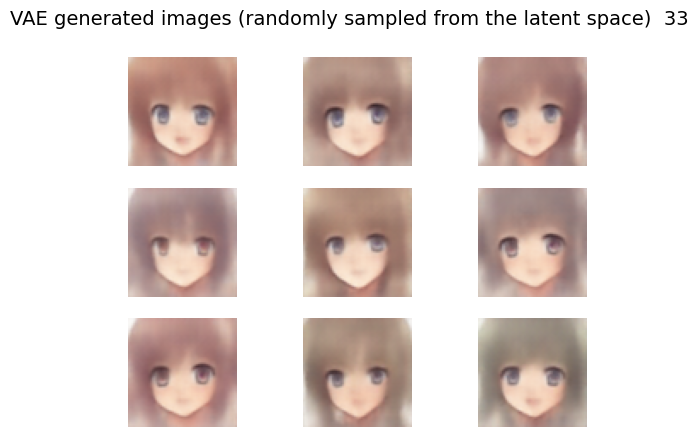


Epoch 35/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5116


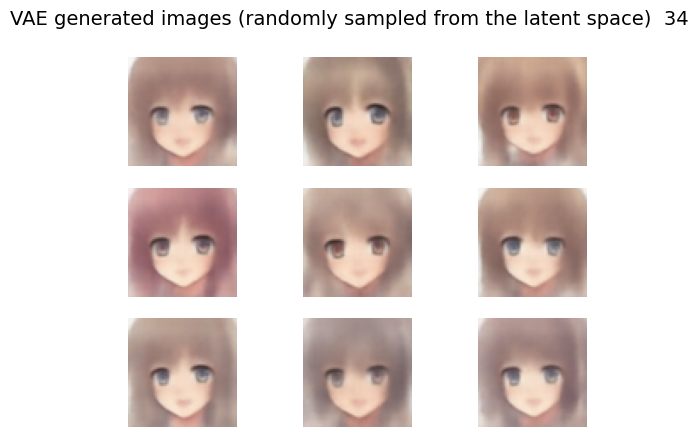


Epoch 36/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5114


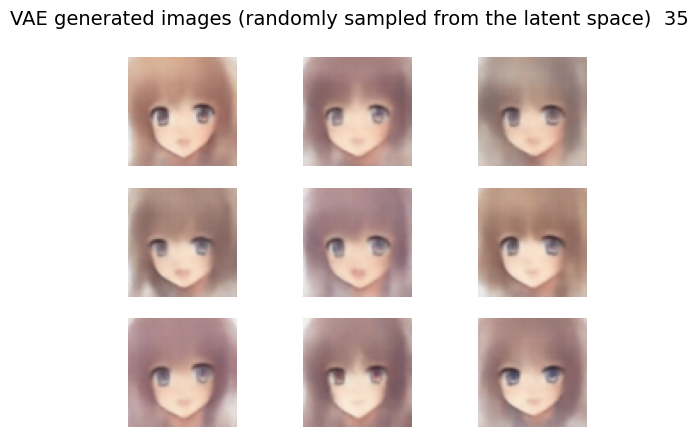


Epoch 37/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5119


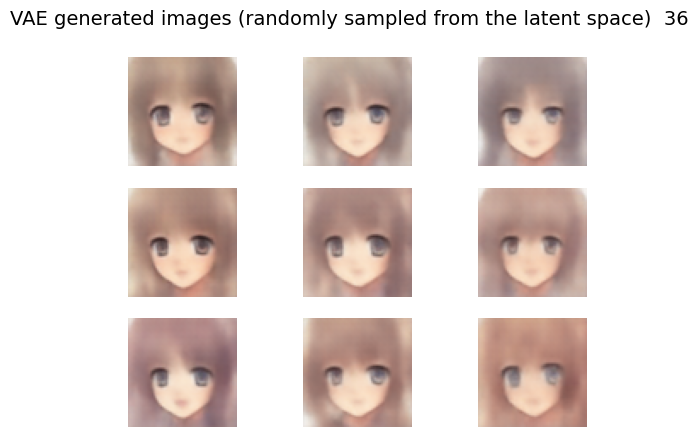


Epoch 38/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5119


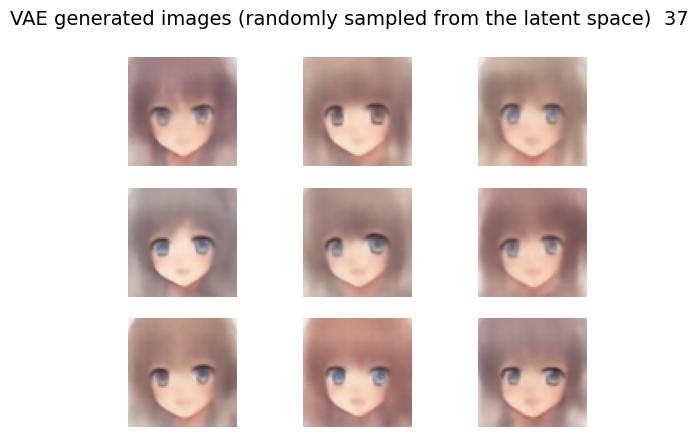


Epoch 39/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5120


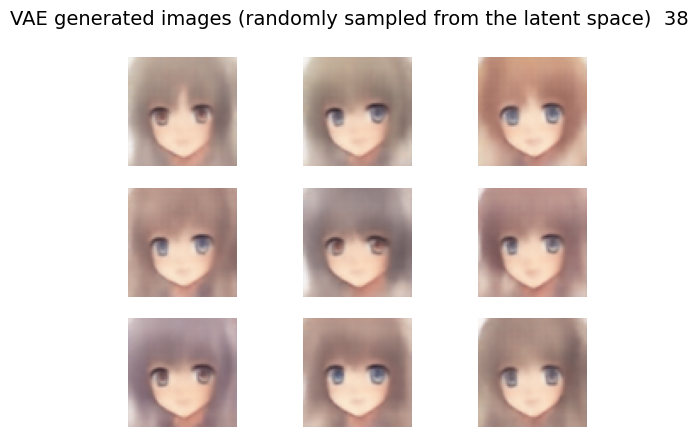


Epoch 40/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5113


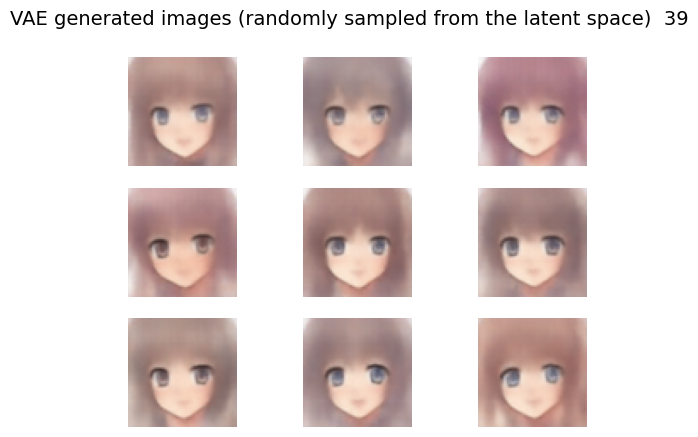


Epoch 41/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5120


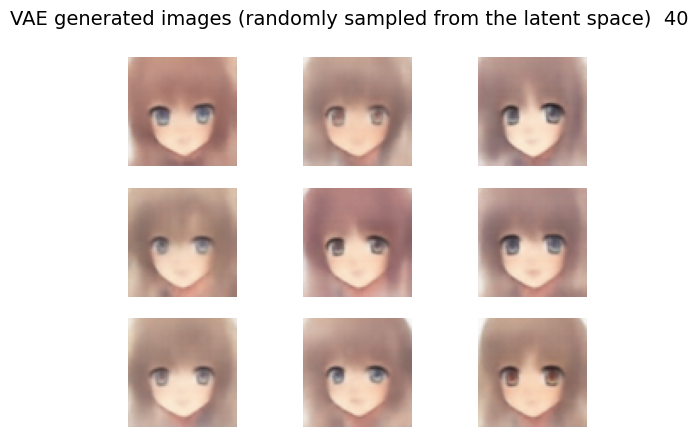


Epoch 42/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5116


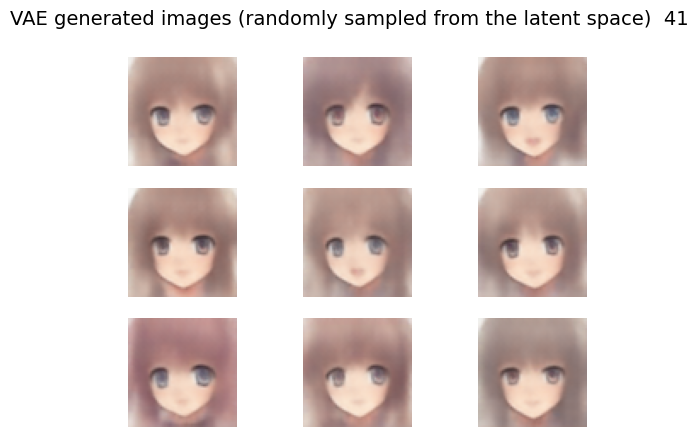


Epoch 43/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5115


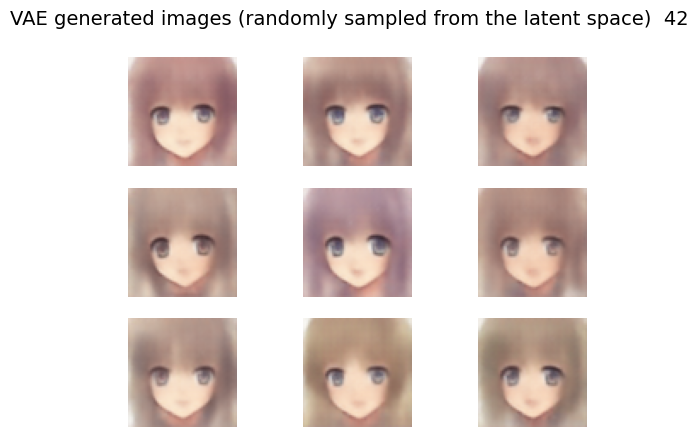


Epoch 44/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5118


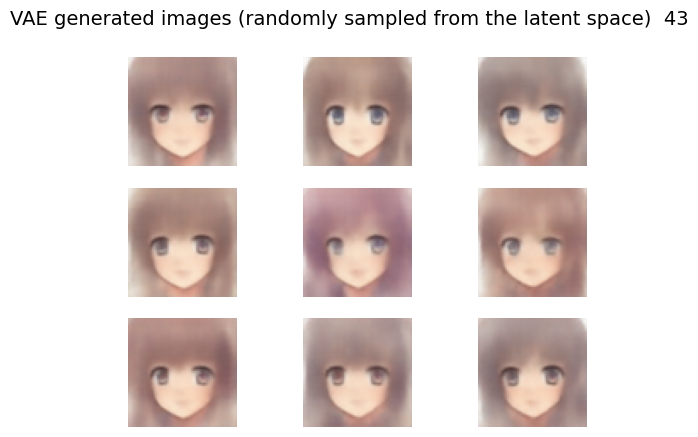


Epoch 45/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5117


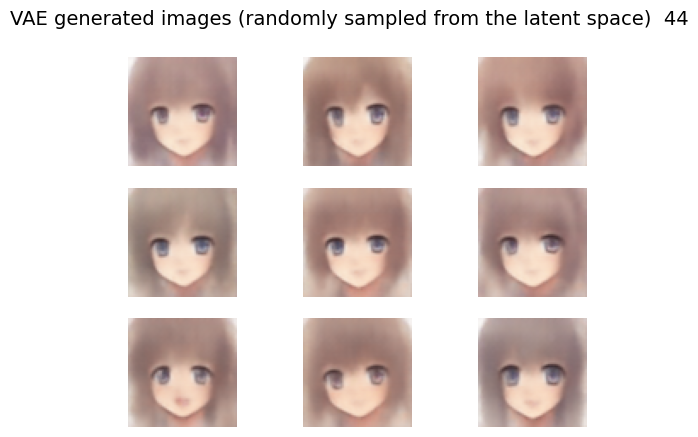


Epoch 46/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5116


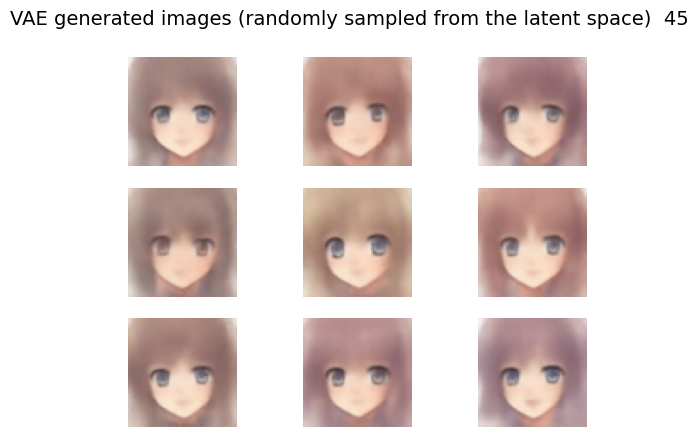


Epoch 47/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5116


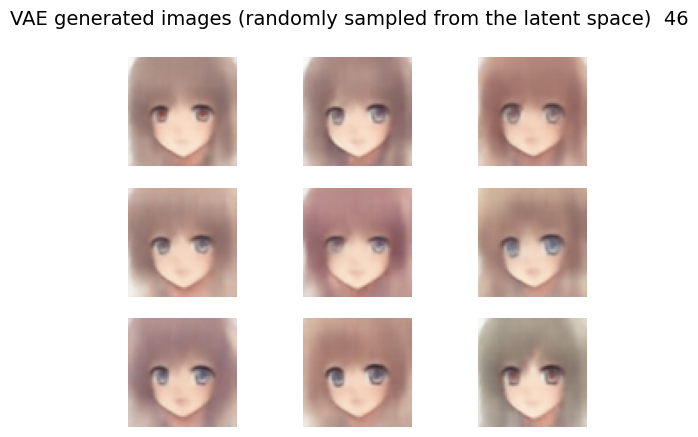


Epoch 48/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5116


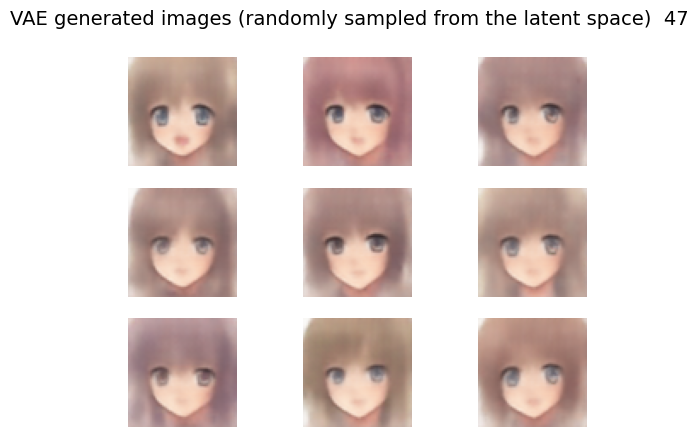


Epoch 49/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 41s 5ms/step - loss: 0.5117


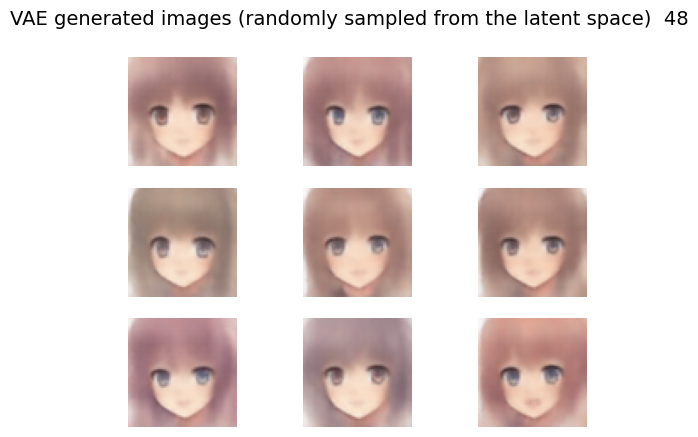


Epoch 50/50
7946/7946 ━━━━━━━━━━━━━━━━━━━━ 42s 5ms/step - loss: 0.5120


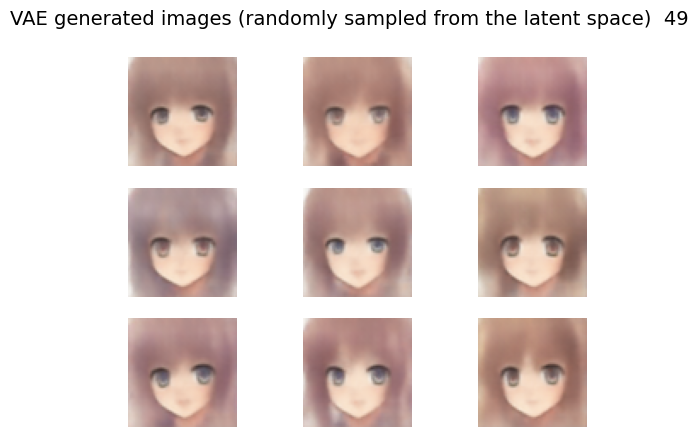

In [ ]:
# Define the latent dimension and build the VAE model
latent_dim = 64
encoder, decoder, vae = build_vae(dataset.shape[1:], latent_dim, filters=64)

# Initialize list to store loss values
vae_loss_values = []

# Training the VAE model
for epoch in range(50):
    print(f"\nEpoch {epoch + 1}/{50}")

    # Train for one epoch and retrieve the loss
    history = vae.fit(x=dataset, y=dataset, epochs=1, batch_size=8, verbose=1)

    # Store the loss value
    vae_loss_values.append(history.history['loss'][0])

    # Generate random latent vectors and visualize the generated images
    latent_vectors = np.random.randn(9, latent_dim) / 6  # Tweak the std if needed
    images = decoder(latent_vectors)
    grid_plot(images, epoch, name='VAE generated images (randomly sampled from the latent space)', n=3, save=False)

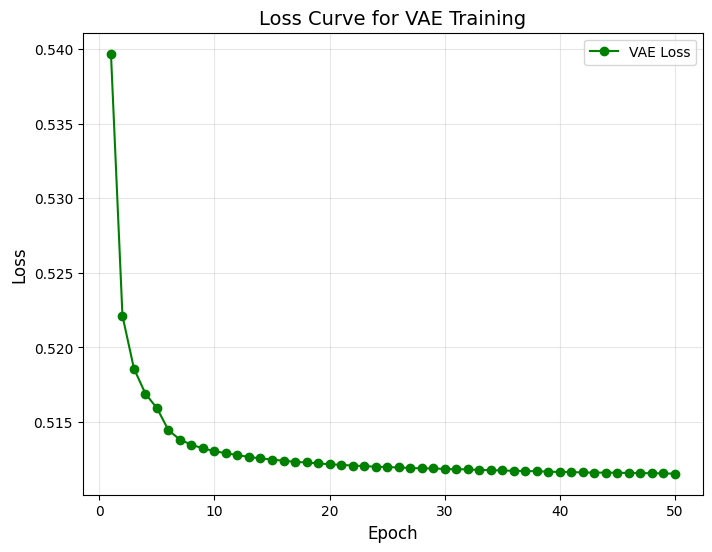

In [ ]:
plt.figure(figsize=(8, 6))
plt.plot(range(1, len(vae_loss_values) + 1), vae_loss_values, marker='o', color='green', label='VAE Loss')
plt.title("Loss Curve for VAE Training", fontsize=14)
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("Loss", fontsize=12)
plt.grid(alpha=0.3)
plt.legend(fontsize=10)
plt.savefig("vae_loss_curve.png", dpi=300, bbox_inches='tight')
plt.show()

### Latent Space Visualization

16/16 ━━━━━━━━━━━━━━━━━━━━ 4s 125ms/step


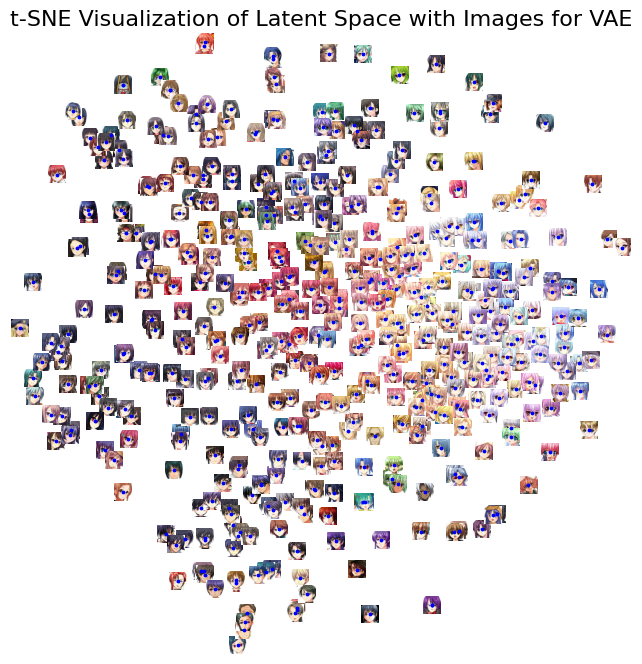

In [ ]:
def visualize_latent_space_with_tsne(encoder, dataset, n_samples=500):
    """
    Visualizes the latent space of the encoder using t-SNE with image overlays.

    Args:
        encoder: The encoder model to extract latent representations.
        dataset: The dataset to visualize.
        n_samples: Number of samples to visualize.
    """
    # Select a random subset of the dataset
    idx = np.random.choice(len(dataset), size=n_samples, replace=False)
    selected_images = dataset[idx]

    # Extract latent representations from the encoder
    latent_vectors = encoder.predict(selected_images)

    # Apply t-SNE to reduce latent vectors to 2D
    tsne = TSNE(n_components=2, random_state=42)
    latent_2d = tsne.fit_transform(latent_vectors)

    # Plot the t-SNE results with images overlaid
    fig, ax = plt.subplots(figsize=(8, 10))
    for point, image in zip(latent_2d, selected_images):
        x, y = point
        ax.imshow(image.squeeze(), extent=(x-0.5, x+0.5, y-0.5, y+0.5), cmap='gray')
        ax.scatter(x, y, s=3, color='blue')

    ax.set_title("t-SNE Visualization of Latent Space with Images for VAE", fontsize=16)
    ax.axis("off")  # Remove axes for cleaner visualization
    plt.show()

# Example usage with the VAE encoder
visualize_latent_space_with_tsne(encoder=encoder, dataset=dataset, n_samples=500)

---

## 2.3 Generative Adversarial Networks (GANs)

### GAN architecture
Generative adversarial networks consist of two models: a generative model and a discriminative model.

<img src="https://media.springernature.com/original/springer-static/image/chp%3A10.1007%2F978-1-4842-3679-6_8/MediaObjects/463582_1_En_8_Fig1_HTML.jpg" width="500">

**The discriminator** model is a classifier that determines whether a given image looks like a real image from the dataset or like an artificially created image. This is basically a binary classifier that will take the form of a normal convolutional neural network (CNN).
As an input this network will get samples both from the dataset that it is trained on and on the samples generated by the **generator**.

The **generator** model takes random input values (noise) and transforms them into images through a deconvolutional neural network.

Over the course of many training iterations, the weights and biases in the discriminator and the generator are trained through backpropagation. The discriminator learns to tell "real" images of handwritten digits apart from "fake" images created by the generator. At the same time, the generator uses feedback from the discriminator to learn how to produce convincing images that the discriminator can't distinguish from real images.




### Definining custom functions for training your GANs

---




*Note: the samples generated by small GANs are more diverse, when compared to VAEs, however some samples might look strange and do not resemble the data the model was trained on.

In [11]:
from tensorflow import keras
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Flatten, Conv2D, Conv2DTranspose, Reshape, BatchNormalization, Dropout
def Discriminator():
  discriminator = Sequential()
  discriminator.add(Conv2D(filters=64, kernel_size=3, strides=(2,2), padding="same",  activation=keras.layers.LeakyReLU(alpha=0.01), input_shape=(64,64,3)))
  discriminator.add(BatchNormalization())
  discriminator.add(Dropout(0.2))

  discriminator.add(Conv2D(filters=128, kernel_size=3, strides=(2,2), padding="same",  activation=keras.layers.LeakyReLU(alpha=0.01)))
  discriminator.add(BatchNormalization())
  discriminator.add(Dropout(0.2))

  discriminator.add(Conv2D(filters=256, kernel_size=3, strides=(2,2), padding="same", activation=keras.layers.LeakyReLU(alpha=0.01)))
  discriminator.add(BatchNormalization())
  discriminator.add(Dropout(0.2))

  discriminator.add(Flatten())
  discriminator.add(Dropout(0.2))
  discriminator.add(Dense(units=1, activation="sigmoid"))

  return discriminator

D_model = Discriminator()
D_model.summary()

/usr/local/lib/python3.10/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 32, 32, 64)          │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 32, 32, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 32, 32, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 16, 16, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 16, 16, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 16, 16, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 8, 8, 256)           │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 8, 8, 256)           │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 8, 8, 256)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 16384)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 16384)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1)                   │          16,385 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 388,993 (1.48 MB)

 Trainable params: 388,097 (1.48 MB)

 Non-trainable params: 896 (3.50 KB)

In [12]:
latent_dim = 100

def Generator():
  generator = Sequential()
  generator.add(Dense(units=4*4*256, input_shape =[latent_dim], use_bias=False))
  generator.add(Reshape((4,4,256)))
  generator.add(BatchNormalization())

  generator.add(Conv2DTranspose(filters=128, kernel_size=(3, 3), strides=(2, 2), padding ="same", activation ="relu"))
  generator.add(BatchNormalization())

  generator.add(Conv2DTranspose(filters=128, kernel_size=(3, 3), strides=(2, 2), padding ="same", activation ="relu"))
  generator.add(BatchNormalization())

  generator.add(Conv2DTranspose(filters=128, kernel_size=(3, 3), strides=(2, 2), padding ="same", activation ="relu"))
  generator.add(BatchNormalization())

  generator.add(Conv2DTranspose(filters=3, kernel_size=(3, 3), strides=(2, 2), padding ="same", activation ="tanh"))

  return generator


# a summary of the Generetor
G_model = Generator()
G_model.summary()

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_1 (Dense)                      │ (None, 4096)                │         409,600 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape (Reshape)                    │ (None, 4, 4, 256)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_3                │ (None, 4, 4, 256)           │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose (Conv2DTranspose)   │ (None, 8, 8, 128)           │         295,040 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_4                │ (None, 8, 8, 128)           │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_1 (Conv2DTranspose) │ (None, 16, 16, 128)         │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_5                │ (None, 16, 16, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_2 (Conv2DTranspose) │ (None, 32, 32, 128)         │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_6                │ (None, 32, 32, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_3 (Conv2DTranspose) │ (None, 64, 64, 3)           │           3,459 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 1,005,827 (3.84 MB)

 Trainable params: 1,004,547 (3.83 MB)

 Non-trainable params: 1,280 (5.00 KB)

In [13]:
class GAN(tf.keras.Model):
    def __init__(self, discriminator, generator, latent_dim):
        super(GAN, self).__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim

    def compile(self, d_optimizer, g_optimizer, loss_fn):
        super(GAN, self).compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.loss_fn = loss_fn
        self.d_loss_metric = tf.keras.metrics.Mean(name="d_loss")
        self.g_loss_metric = tf.keras.metrics.Mean(name="g_loss")

    @property
    def metrics(self):
        return [self.d_loss_metric, self.g_loss_metric]

    def train_step(self, real_images):
        batch_size = tf.shape(real_images)[0]
        seed = tf.random.normal(shape=(batch_size, self.latent_dim))
        generated_images = self.generator(seed)
        combined_images = tf.concat([generated_images, real_images], axis=0)
        labels = tf.concat([tf.ones((batch_size, 1)), tf.zeros((batch_size, 1))], axis=0)
        labels += 0.05 * tf.random.uniform(tf.shape(labels))
        with tf.GradientTape() as tape:
            predictions = self.discriminator(combined_images)
            d_loss = self.loss_fn(labels, predictions)
        grads = tape.gradient(d_loss, self.discriminator.trainable_weights)
        self.d_optimizer.apply_gradients(zip(grads, self.discriminator.trainable_weights))
        seed = tf.random.normal(shape=(batch_size, self.latent_dim))
        misleading_labels = tf.zeros((batch_size, 1))
        with tf.GradientTape() as tape:
            predictions = self.discriminator(self.generator(seed))
            g_loss = self.loss_fn(misleading_labels, predictions)
        grads = tape.gradient(g_loss, self.generator.trainable_weights)
        self.g_optimizer.apply_gradients(zip(grads, self.generator.trainable_weights))
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)
        return {"d_loss": self.d_loss_metric.result(), "g_loss": self.g_loss_metric.result()}

In [26]:
class LossesHistory(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        # Append discriminator and generator losses at the end of each epoch
        d_loss = logs.get('d_loss')
        g_loss = logs.get('g_loss')
        if d_loss is not None and g_loss is not None:
            self.d_losses.append(d_loss)
            self.g_losses.append(g_loss)

    def on_train_begin(self, logs=None):
        # Initialize the lists to store losses
        self.d_losses = []
        self.g_losses = []

# Optimizers and loss function
G_optm = tf.keras.optimizers.Adam(1e-4)
D_optm = tf.keras.optimizers.Adam(1e-4)
loss_fn = tf.keras.losses.BinaryCrossentropy()

# Create and compile the GAN
model = GAN(discriminator=D_model, generator=G_model, latent_dim=latent_dim)
model.compile(d_optimizer=D_optm, g_optimizer=G_optm, loss_fn=loss_fn)

# Initialize the custom callback
history_callback = LossesHistory()

# Training the GAN
epochs = 50
history = model.fit(dataset, epochs=epochs, callbacks=[history_callback])

Epoch 1/50
1987/1987 ━━━━━━━━━━━━━━━━━━━━ 21s 7ms/step - d_loss: 0.3192 - g_loss: 2.5033
Epoch 2/50
1987/1987 ━━━━━━━━━━━━━━━━━━━━ 10s 5ms/step - d_loss: 0.3175 - g_loss: 2.3733
Epoch 3/50
1987/1987 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - d_loss: 0.3404 - g_loss: 2.1531
Epoch 4/50
1987/1987 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - d_loss: 0.3605 - g_loss: 2.2101
Epoch 5/50
1987/1987 ━━━━━━━━━━━━━━━━━━━━ 10s 5ms/step - d_loss: 0.3669 - g_loss: 2.1359
Epoch 6/50
1987/1987 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - d_loss: 0.3620 - g_loss: 2.0999
Epoch 7/50
1987/1987 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - d_loss: 0.3365 - g_loss: 2.2025
Epoch 8/50
1987/1987 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - d_loss: 0.3427 - g_loss: 2.1389
Epoch 9/50
1987/1987 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - d_loss: 0.3266 - g_loss: 2.2450
Epoch 10/50
1987/1987 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - d_loss: 0.3216 - g_loss: 2.2451
Epoch 11/50
1987/1987 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - d_loss: 0.3044 - g_loss: 2.3167
Epoch 12/50
1987/1987 ━━━━━

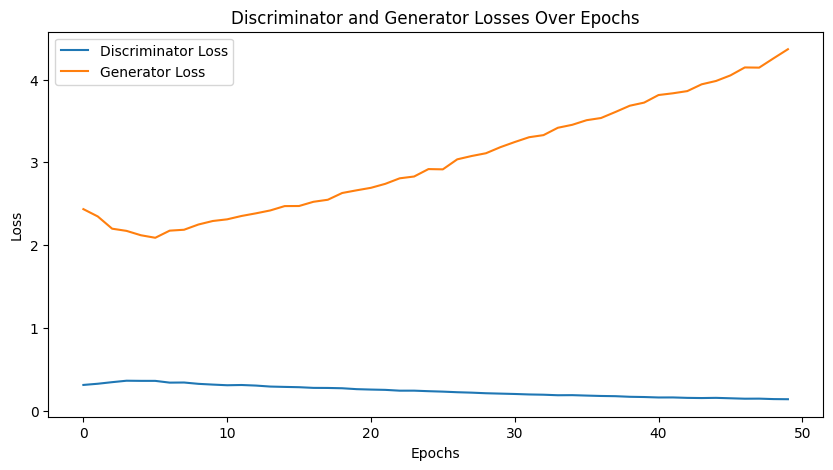

In [27]:
# Access the losses after training
d_losses = history_callback.d_losses
g_losses = history_callback.g_losses

# Plot the losses
plt.figure(figsize=(10, 5))
plt.plot(d_losses, label='Discriminator Loss')
plt.plot(g_losses, label='Generator Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Discriminator and Generator Losses Over Epochs')
plt.legend()
plt.show()

In [30]:
# View generated images
noise = tf.random.normal([32, 100])
generated_images = G_model(noise, training=False)
generated_images1 = (generated_images+127.5)*127.5

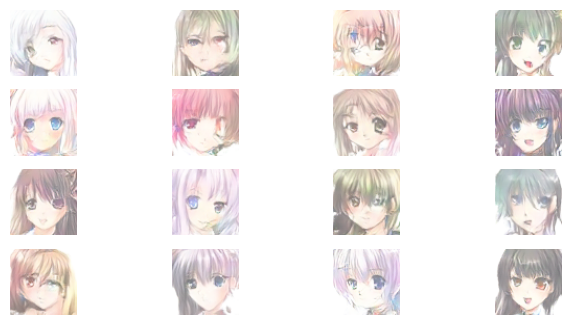

In [31]:
plt.figure(figsize=(8, 5))
for i in range(16):
    ax = plt.subplot(5, 4, i+1)
    plt.imshow(generated_images1[i].numpy().astype("uint8"))
    plt.axis('off')

plt.show()

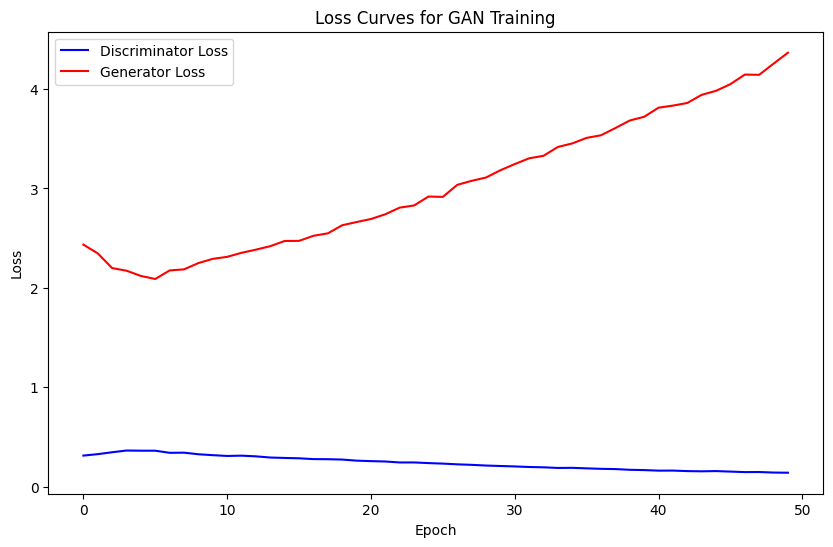

In [32]:
# Plotting the loss curves for both discriminator and generator
def plot_loss_curves(d_losses, g_losses):
    plt.figure(figsize=(10, 6))
    plt.plot(d_losses, label='Discriminator Loss', color='blue')
    plt.plot(g_losses, label='Generator Loss', color='red')
    plt.title('Loss Curves for GAN Training')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

# Plot the loss curves
plot_loss_curves(d_losses, g_losses)

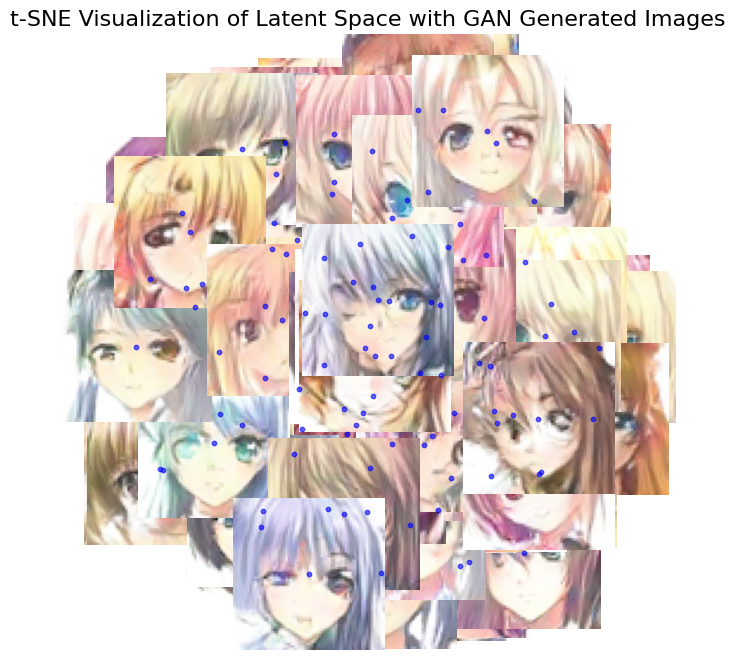

In [33]:
from sklearn.manifold import TSNE
def visualize_latent_space_with_tsne(generator, latent_dim, n_samples=100):
    """
    Visualizes the latent space of the generator model using t-SNE with image overlays.

    Args:
        generator: The generator model of the GAN.
        latent_dim: The dimensionality of the latent space.
        n_samples: The number of latent vectors to visualize.
    """
    # Generate random latent vectors with the correct shape
    latent_vectors = tf.random.normal(shape=(n_samples, latent_dim))

    # Generate images using the latent vectors
    generated_images = generator(latent_vectors, training=False).numpy()

    # Normalize images to [0, 1] range for visualization
    generated_images = (generated_images - np.min(generated_images)) / (np.max(generated_images) - np.min(generated_images))

    # Apply t-SNE to reduce latent vectors to 2D
    tsne = TSNE(n_components=2, random_state=42)
    latent_2d = tsne.fit_transform(latent_vectors)

    # Plot the t-SNE results with images overlaid
    fig, ax = plt.subplots(figsize=(8, 8))
    for point, img in zip(latent_2d, generated_images):
        x, y = point
        img = np.squeeze(img)  # Ensure image is properly shaped
        # Overlay each image at the corresponding t-SNE coordinates
        ax.imshow(img, extent=(x - 1, x + 1, y - 1, y + 1), cmap='gray' if len(img.shape) == 2 else None)
        ax.scatter(x, y, s=10, color='blue', alpha=0.6)

    ax.set_title("t-SNE Visualization of Latent Space with GAN Generated Images", fontsize=16)
    ax.axis("off")  # Remove axes for cleaner visualization
    plt.show()

latent_dim = 100
visualize_latent_space_with_tsne(generator=G_model, latent_dim=latent_dim, n_samples=100)

### Evaluating the models

Evaluation of Convolutional Autoencoder (CAE)


- cae.predict(dataset) reconstructs the input images.
- We visualize both original and reconstructed images.
- MSE is calculated between the original and reconstructed images to quantify reconstruction performance.

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step


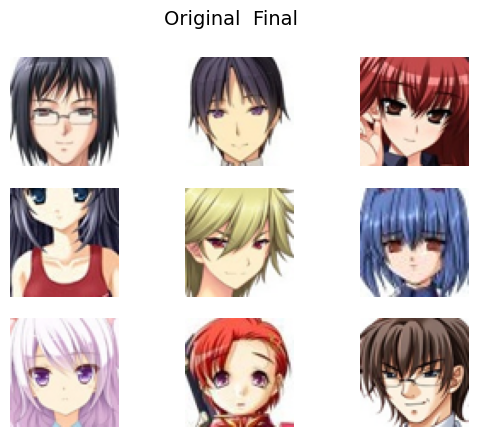

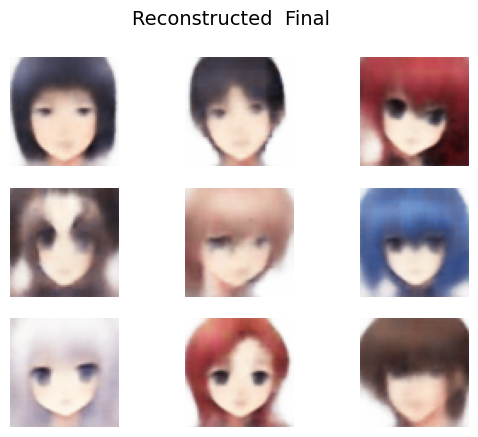

Mean Squared Error (MSE) for CAE: 0.02212576595140055


In [ ]:
# Evaluate CAE on test set
reconstructed_images = cae.predict(dataset)  # Reconstruct the dataset

# Visualizing the original vs reconstructed images
samples = dataset[:9]
grid_plot(samples, epoch='Final', name='Original', n=3, save=False)
grid_plot(reconstructed_images[:9], epoch='Final', name='Reconstructed', n=3, save=False)

# Compute Mean Squared Error (MSE) between original and reconstructed images
from sklearn.metrics import mean_squared_error
mse = mean_squared_error(samples.reshape(-1, samples.shape[1] * samples.shape[2] * samples.shape[3]),
                         reconstructed_images[:9].reshape(-1, reconstructed_images.shape[1] * reconstructed_images.shape[2] * reconstructed_images.shape[3]))
print(f'Mean Squared Error (MSE) for CAE: {mse}')

Evaluation of Variational Autoencoder (VAE)

- The resizing ensures that the images are compatible with InceptionV3, which expects images of at least 75x75 pixels.
- The FID score helps in assessing the quality of the generated images by comparing the distribution of features in the real and generated images.

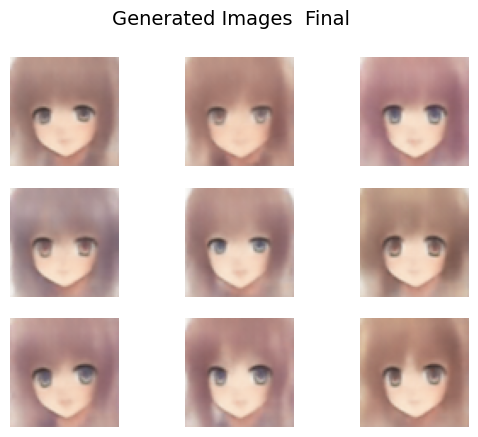

87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 4s 0us/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
FID Score: (1989424.073948747-0.00371809849335757j)


In [ ]:
from tensorflow.keras.preprocessing.image import img_to_array, array_to_img
from tensorflow.keras.applications import InceptionV3
from scipy.linalg import sqrtm

# Generating new samples from the VAE's latent space
generated_images = decoder(latent_vectors)

# Visualizing the generated images
grid_plot(generated_images, epoch='Final', name='Generated Images', n=3, save=False)

# Resize function to change image dimensions to 75x75
def resize_images(images, size=(75, 75)):
    return np.array([img_to_array(array_to_img(image).resize(size)) for image in images])

# Resize the real and generated images
real_images_resized = resize_images((dataset[:9] + 1) / 2.0)  # Rescale real images
generated_images_resized = resize_images((generated_images + 1) / 2.0)  # Rescale generated images

# FID score calculation
def calculate_fid(real_images, generated_images):
    model = InceptionV3(include_top=False, pooling='avg', input_shape=(75, 75, 3))

    # Calculate features for real and generated images
    real_features = model.predict(real_images)
    generated_features = model.predict(generated_images)

    mu_real, sigma_real = real_features.mean(axis=0), np.cov(real_features, rowvar=False)
    mu_fake, sigma_fake = generated_features.mean(axis=0), np.cov(generated_features, rowvar=False)

    diff = mu_real - mu_fake
    covmean = sqrtm(sigma_real.dot(sigma_fake))
    fid = diff.dot(diff) + np.trace(sigma_real + sigma_fake - 2 * covmean)
    return fid

# Optional: calculate FID score using resized images
fid_score = calculate_fid(real_images_resized, generated_images_resized)
print(f'FID Score: {fid_score}')

 Evaluation of Generative Adversarial Network (GAN)

- Qualitative Evaluation: Visualize the generated images from the GAN by feeding random noise into the generator.
- FID Score: Like the VAE, compute the FID score to quantify the quality of generated images by comparing real vs. generated distributions.

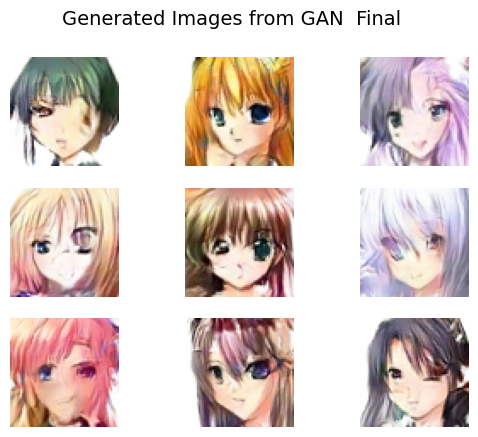

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
FID Score for GAN: (1495560.5812288842-0.0339901697734827j)


In [34]:
# Visualize the generated images from the GAN after training
noise = tf.random.normal(shape=(9, latent_dim))  # Generate random latent vectors
generated_images = G_model(noise, training=False)  # Generate images from the GAN, using G_model instead of generator

# Display the generated images
grid_plot(generated_images.numpy(), epoch='Final', name='Generated Images from GAN', n=3, save=False)

# Re-define resize_images here (Copied from the VAE evaluation section)
from tensorflow.keras.preprocessing.image import img_to_array, array_to_img
def resize_images(images, size=(75, 75)):
    return np.array([img_to_array(array_to_img(image).resize(size)) for image in images])

# Resize real and generated images to 75x75 (same as for VAE)
real_images_resized = resize_images((dataset[:9] + 1) / 2.0)  # Rescale and resize real images
generated_images_resized = resize_images((generated_images.numpy() + 1) / 2.0)  # Rescale and resize generated images

# Re-define calculate_fid function here to make it accessible
from tensorflow.keras.applications import InceptionV3
from scipy.linalg import sqrtm
def calculate_fid(real_images, generated_images):
    model = InceptionV3(include_top=False, pooling='avg', input_shape=(75, 75, 3))

    # Calculate features for real and generated images
    real_features = model.predict(real_images)
    generated_features = model.predict(generated_images)

    mu_real, sigma_real = real_features.mean(axis=0), np.cov(real_features, rowvar=False)
    mu_fake, sigma_fake = generated_features.mean(axis=0), np.cov(generated_features, rowvar=False)

    diff = mu_real - mu_fake
    covmean = sqrtm(sigma_real.dot(sigma_fake))
    fid = diff.dot(diff) + np.trace(sigma_real + sigma_fake - 2 * covmean)
    return fid

# Calculate FID score for GAN
fid_score_gan = calculate_fid(real_images_resized, generated_images_resized)
print(f'FID Score for GAN: {fid_score_gan}')